<div style="background-color:#e6f5e6;">
<br/>
<div style="text-align:center;">
  <img src="retail_gif.gif" alt="Retail Analytics" style="height:300px; width:400px;">
</div>
<div style="text-align:center; color:black;">
<h2>Capstone Project 7</h2>
<h3>Retail Analytics</h3>
</div><br/>
</div>
<hr/>

### BY GROUP 15 :
| Name               | Registration_Id|
|--------------------|----------------|
| SANJEEP ROUT       | 2041018144     |
| JEET ACHARYA       | 2041001009     |
| PALAK AGARWAL      | 2041001024     |
| AMRUTTA DHAL       | 2041004146     |
| PRIYAJIT GANTAYAT  | 2041007003     |
| RISHU KUMAR        | 2041011066     |

### Details 

A retail company “ABC Private Limited” wants to understand the customer purchase 
behaviour (specifically, purchase amount) against various products of different categories. 
They have shared purchase summary of various customers for selected high-volume products 
from last month. 

In [2]:
# manipulation data
import pandas as pd
import numpy as np

#visualiation data
import matplotlib.pyplot as plt
import seaborn as sns 
import matplotlib
import plotly.express as px
%matplotlib inline 

import warnings  
warnings.filterwarnings("ignore")

#default theme
plt.style.use('ggplot')
sns.set(context='notebook', style='darkgrid', palette='colorblind', font='sans-serif', font_scale=1, rc=None)
plt.rcParams['figure.figsize'] =[10,6]
plt.rcParams.update({'font.size': 15})
plt.rcParams['font.family'] = 'sans-serif'

## LOAD THE DATASET

In [3]:
# files imports 
# a. Load the dataset
user_demographics = r"P:\0011 NOTES\aii+ml-comviva\Capstone_Project_7\user_demographics.csv"
user_purchase_details = r"P:\0011 NOTES\aii+ml-comviva\Capstone_Project_7\User_product_purchase_details_p2.csv"

In [4]:
# data details
df1 = pd.read_csv(user_demographics)
df2 = pd.read_csv(user_purchase_details)

## DATA EXPLORATION

### * user_demographics data and user_product_purchase_details

In [5]:
df1


,User_ID,Gender,Age,Occupation
0,1000001,F,0-17,10
1,1000002,M,55+,16
2,1000003,M,26-35,15
3,1000004,M,46-50,7
4,1000005,M,26-35,20
...,...,...,...,...
5886,1004588,F,26-35,4
5887,1004871,M,18-25,12
5888,1004113,M,36-45,17
5889,1005391,M,26-35,7


In [6]:
df2

,User_ID,Product_ID,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,A,2,0,3,NaN,NaN,8370
1,1000001,P00248942,A,2,0,1,6.0,14.0,15200
2,1000001,P00087842,A,2,0,12,NaN,NaN,1422
3,1000001,P00085442,A,2,0,12,14.0,NaN,1057
4,1000002,P00285442,C,4+,0,8,NaN,NaN,7969
...,...,...,...,...,...,...,...,...,...
550063,1006033,P00372445,B,1,1,20,NaN,NaN,368
550064,1006035,P00375436,C,3,0,20,NaN,NaN,371
550065,1006036,P00375436,B,4+,1,20,NaN,NaN,137
550066,1006038,P00375436,C,2,0,20,NaN,NaN,365


In [7]:
print(df1.groupby('User_ID').size())
print('\n\n')
print(df2.groupby('User_ID').size())


User_ID
1000001    1
1000002    1
1000003    1
1000004    1
1000005    1
          ..
1006036    1
1006037    1
1006038    1
1006039    1
1006040    1
Length: 5891, dtype: int64



User_ID
1000001     35
1000002     77
1000003     29
1000004     14
1000005    106
          ... 
1006036    514
1006037    122
1006038     12
1006039     74
1006040    180
Length: 5891, dtype: int64


In [8]:
print(df1.info())
print('\n\n')
print(df2.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5891 entries, 0 to 5890
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   User_ID     5891 non-null   int64 
 1   Gender      5891 non-null   object
 2   Age         5891 non-null   object
 3   Occupation  5891 non-null   int64 
dtypes: int64(2), object(2)
memory usage: 184.2+ KB
None



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 9 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   User_ID                     550068 non-null  int64  
 1   Product_ID                  550068 non-null  object 
 2   City_Category               550068 non-null  object 
 3   Stay_In_Current_City_Years  550068 non-null  object 
 4   Marital_Status              550068 non-null  int64  
 5   Product_Category_1          550068 non-null  int64  
 6   Product_Categor

In [9]:
print(df1.describe())
print('\n\n')
print(df2.describe())


            User_ID   Occupation
count  5.891000e+03  5891.000000
mean   1.003025e+06     8.153285
std    1.743379e+03     6.323140
min    1.000001e+06     0.000000
25%    1.001518e+06     3.000000
50%    1.003026e+06     7.000000
75%    1.004532e+06    14.000000
max    1.006040e+06    20.000000





            User_ID  Marital_Status  Product_Category_1  Product_Category_2  \
count  5.500680e+05   550068.000000       550068.000000       376430.000000   
mean   1.003029e+06        0.409653            5.404270            9.842329   
std    1.727592e+03        0.491770            3.936211            5.086590   
min    1.000001e+06        0.000000            1.000000            2.000000   
25%    1.001516e+06        0.000000            1.000000            5.000000   
50%    1.003077e+06        0.000000            5.000000            9.000000   
75%    1.004478e+06        1.000000            8.000000           15.000000   
max    1.006040e+06        1.000000           20.000000           18.000000   

       Product_Category_3       Purchase  
count       166821.000000  550068.000000  
mean            12.668243    9263.968713  
std              4.125338    5023.065394  
min              3.000000      12.000000  
25%              9.000000    5823.000000  
50%             14.000000    8

In [10]:
print(df1.shape)
print(df2.shape)

(5891, 4)
(550068, 9)


In [11]:
# unique entries
print('user demographics- \n')
for column_name in df1.columns:
    unique_entries_count = df1[column_name].nunique()
    print(f"Number of unique entries in '{column_name}': {unique_entries_count}")
print('\n\n')
print('user purchase details - \n')
for column_name in df2.columns:
    unique_entries_count = df2[column_name].nunique()
    print(f"Number of unique entries in '{column_name}': {unique_entries_count}")

user demographics- 

Number of unique entries in 'User_ID': 5891
Number of unique entries in 'Gender': 2
Number of unique entries in 'Age': 7
Number of unique entries in 'Occupation': 21



user purchase details - 

Number of unique entries in 'User_ID': 5891
Number of unique entries in 'Product_ID': 3631
Number of unique entries in 'City_Category': 3
Number of unique entries in 'Stay_In_Current_City_Years': 5
Number of unique entries in 'Marital_Status': 2
Number of unique entries in 'Product_Category_1': 20
Number of unique entries in 'Product_Category_2': 17
Number of unique entries in 'Product_Category_3': 15
Number of unique entries in 'Purchase': 18105


In [12]:
# missing values in data
print('user demographics- \n', df1.isnull().sum())
print('\n\n')
print('user purchase details - \n', df2.isnull().sum())

user demographics- 
 User_ID       0
Gender        0
Age           0
Occupation    0
dtype: int64



user purchase details - 
 User_ID                            0
Product_ID                         0
City_Category                      0
Stay_In_Current_City_Years         0
Marital_Status                     0
Product_Category_1                 0
Product_Category_2            173638
Product_Category_3            383247
Purchase                           0
dtype: int64


In [13]:
# duplicated values in data
print('user demographics- \n', df1[df1.duplicated()].sum())
print('\n\nuser purchase details - \n', df2[df2.duplicated()].sum())

user demographics- 
 User_ID       0
Gender        0
Age           0
Occupation    0
dtype: object


user purchase details - 
 User_ID                         0
Product_ID                      0
City_Category                   0
Stay_In_Current_City_Years      0
Marital_Status                  0
Product_Category_1              0
Product_Category_2            0.0
Product_Category_3            0.0
Purchase                        0
dtype: object


### MERGE THE DATASET


In [14]:
new_df= pd.merge(df1, df2, on= "User_ID", how= "right")
new_df

,User_ID,Gender,Age,Occupation,Product_ID,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,F,0-17,10,P00069042,A,2,0,3,NaN,NaN,8370
1,1000001,F,0-17,10,P00248942,A,2,0,1,6.0,14.0,15200
2,1000001,F,0-17,10,P00087842,A,2,0,12,NaN,NaN,1422
3,1000001,F,0-17,10,P00085442,A,2,0,12,14.0,NaN,1057
4,1000002,M,55+,16,P00285442,C,4+,0,8,NaN,NaN,7969
...,...,...,...,...,...,...,...,...,...,...,...,...
550063,1006033,M,51-55,13,P00372445,B,1,1,20,NaN,NaN,368
550064,1006035,F,26-35,1,P00375436,C,3,0,20,NaN,NaN,371
550065,1006036,F,26-35,15,P00375436,B,4+,1,20,NaN,NaN,137
550066,1006038,F,55+,1,P00375436,C,2,0,20,NaN,NaN,365


In [15]:
# make the data set more user friendly by replacing with useful names
new_df.columns = new_df.columns.str.strip().str.lower().str.replace(' ', '_').str.replace('(', '').str.replace(')', '')
new_df

,user_id,gender,age,occupation,product_id,city_category,stay_in_current_city_years,marital_status,product_category_1,product_category_2,product_category_3,purchase
0,1000001,F,0-17,10,P00069042,A,2,0,3,NaN,NaN,8370
1,1000001,F,0-17,10,P00248942,A,2,0,1,6.0,14.0,15200
2,1000001,F,0-17,10,P00087842,A,2,0,12,NaN,NaN,1422
3,1000001,F,0-17,10,P00085442,A,2,0,12,14.0,NaN,1057
4,1000002,M,55+,16,P00285442,C,4+,0,8,NaN,NaN,7969
...,...,...,...,...,...,...,...,...,...,...,...,...
550063,1006033,M,51-55,13,P00372445,B,1,1,20,NaN,NaN,368
550064,1006035,F,26-35,1,P00375436,C,3,0,20,NaN,NaN,371
550065,1006036,F,26-35,15,P00375436,B,4+,1,20,NaN,NaN,137
550066,1006038,F,55+,1,P00375436,C,2,0,20,NaN,NaN,365


In [16]:
new_df.describe(include='all')

,user_id,gender,age,occupation,product_id,city_category,stay_in_current_city_years,marital_status,product_category_1,product_category_2,product_category_3,purchase
count,5.500680e+05,550068,550068,550068.000000,550068,550068,550068,550068.000000,550068.000000,376430.000000,166821.000000,550068.000000
unique,NaN,2,7,NaN,3631,3,5,NaN,NaN,NaN,NaN,NaN
top,NaN,M,26-35,NaN,P00265242,B,1,NaN,NaN,NaN,NaN,NaN
freq,NaN,414259,219587,NaN,1880,231173,193821,NaN,NaN,NaN,NaN,NaN
mean,1.003029e+06,NaN,NaN,8.076707,NaN,NaN,NaN,0.409653,5.404270,9.842329,12.668243,9263.968713
std,1.727592e+03,NaN,NaN,6.522660,NaN,NaN,NaN,0.491770,3.936211,5.086590,4.125338,5023.065394
min,1.000001e+06,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000,1.000000,2.000000,3.000000,12.000000
25%,1.001516e+06,NaN,NaN,2.000000,NaN,NaN,NaN,0.000000,1.000000,5.000000,9.000000,5823.000000
50%,1.003077e+06,NaN,NaN,7.000000,NaN,NaN,NaN,0.000000,5.000000,9.000000,14.000000,8047.000000
75%,1.004478e+06,NaN,NaN,14.000000,NaN,NaN,NaN,1.000000,8.000000,15.000000,16.000000,12054.000000


### ABOUT THE DATASET


* User_ID: A distinct ID is given to the customers to identify them uniquely.
* Product_ID: A distinct ID is given to products to identify them uniquely.
* Gender: M or F can be used as a binary variable.
* Age: Age is given in bins with 6 categories.
* Occupation: The type of occupation a user does, it is already masked.
* City_Category: The category of the city out of A, B, C. Should be used as Categorical Variable.
* Stay_In_Current_City_Years: It has 5 values: 0, 1, 2, 3, 4+ and may be used as categorical variables.
* Marital_Status: 0: Unmarried and 1: Married. It is expected that marital status does affect the Purchase value.
* Product_Category_1: The primary category that a product belongs to. It can be a useful feature as some certain category of products are sold more often than others.
* Product_Category_2: The Secondary category of a product. If there is no secondary category this will be Null.
* Product_Category_3: The Tertiary Category of a product. This will be only occupied when Category 1 and 2 are occupied. Also, if a product does not have a tertiary category, it will be Null.
* Purchase: This is the target variable.

| Variable                  | Definition                                        |
|---------------------------|---------------------------------------------------|
| User_ID                   | User ID                                           |
| Product_ID                | Product ID                                        |
| Gender                    | Sex of User                                       |
| Age                       | Age in bins                                       |
| Occupation                | Occupation (Masked)                               |
| City_Category             | Category of the City (A,B,C)                      |
| Stay_In_Current_City_Years | Number of years stay in the current city         |
| Marital_Status            | Marital Status                                    |
| Product_Category_1        | Product Category (Masked)                         |
| Product_Category_2        | Product may belong to another category also   (Masked)                                          |
| Product_Category_3        | Product may belong to another category also   (Masked)                                          |
| Purchase                  | Purchase Amount (Target Variable)                 |








### Univariate analysis

Skew of Purchase column is: 0.6001400037087128
Kurtosis of Purchase column is: -0.338378


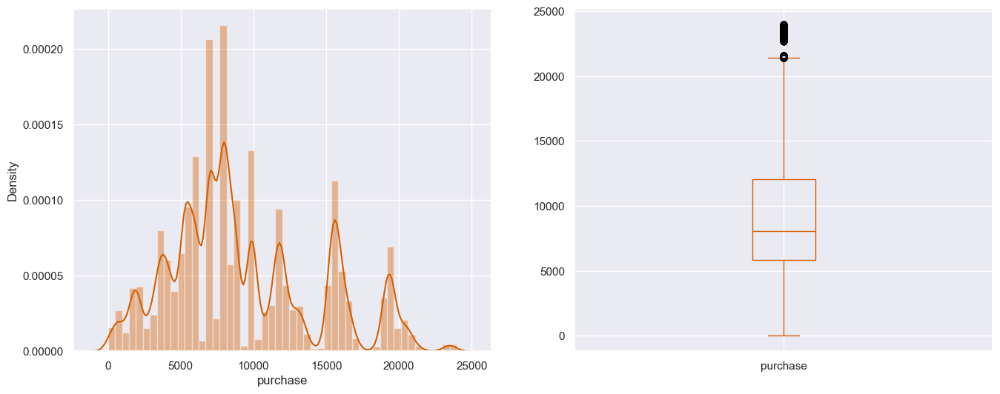

In [17]:
# visualizes the distribution of purchase amounts and provides an idea of how the data is spread
print ("Skew of Purchase column is:", new_df['purchase'].skew())
print("Kurtosis of Purchase column is: %f" % new_df['purchase'].kurt())
plt.figure(1)
plt.subplot(121)
sns.distplot(new_df["purchase"], color='r')

plt.subplot(122)
# shows the distribution of the data's median, quartiles, and outliers, giving insights into the data's central tendency and variability
new_df["purchase"].plot.box(figsize = (16, 6), color='r')
plt.show()

Counts - 
 gender
M    414259
F    135809
Name: count, dtype: int64

Percentage - 
 gender
M    75.310507
F    24.689493
Name: proportion, dtype: float64


([<matplotlib.patches.Wedge at 0x207831dd350>,
 [Text(-0.785367774085001, 0.7701931312526561, 'Male'),
  Text(0.8567647657901591, -0.840210768855371, 'Female')],
 [Text(-0.42838242222818235, 0.42010534431963054, '75.31%'),
  Text(0.49977944671092617, -0.49012294849896637, '24.69%')])

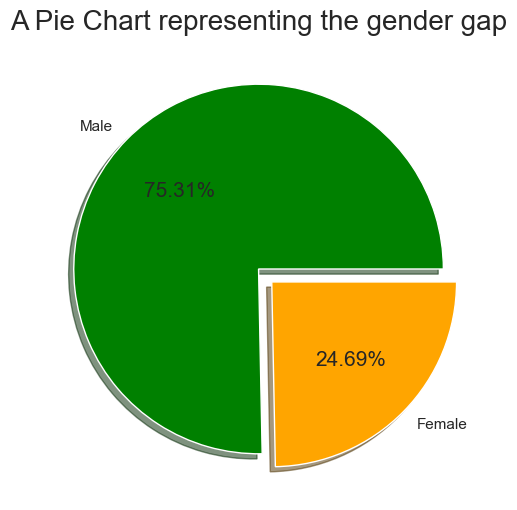

In [18]:
# to vizualize gender ratio and gain insights
labels = ['Male', 'Female']
colors = ['Green', 'Orange']
explode = [0, 0.1]
print("Counts - \n", new_df["gender"].value_counts())
print("\nPercentage - \n", new_df['gender'].value_counts(normalize=True)*100)
plt.title('A Pie Chart representing the gender gap', fontsize = 20)
plt.pie(new_df['gender'].value_counts(), colors = colors, labels = labels, shadow = True, explode = explode, autopct = '%.2f%%')

<Axes: title={'center': 'Mean Purchase of Different Genders'}, xlabel='gender', ylabel='purchase'>

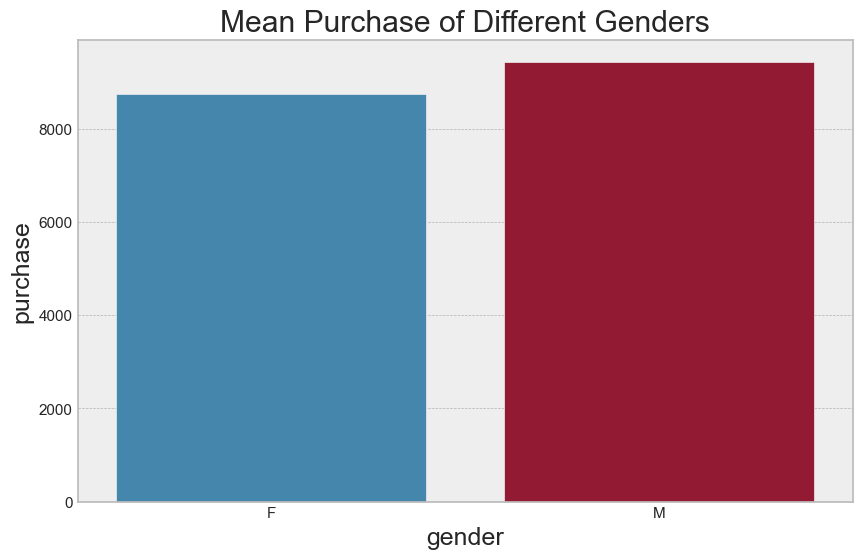

In [37]:
# gender_plot = new_df.pivot_table(index='gender', values='purchase', aggfunc='mean')
# plt.title("Mean Purchase of Different Genders")
# sns.barplot(x=gender_plot.index, y='purchase', data=gender_plot)

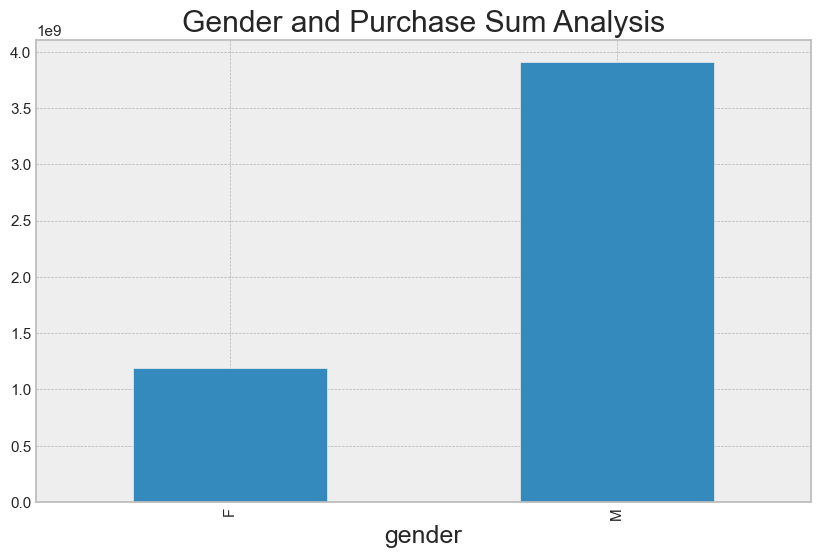

In [33]:
# new_df.groupby('gender').sum()['purchase'].plot(kind='bar')
# plt.title("Gender and Purchase Sum Analysis")
# plt.show()

In [19]:
# to visualize the no. of years with respect to the data 
age=new_df['age'].value_counts()
print("Age counts- \n", age)
fig=px.bar(age, y=age, x=age.index, color=age.index, template='ggplot2')
fig.update_layout(
    title= 'Age Distribution',
    xaxis_title= 'Age',
    yaxis_title="Count",
    legend_title='Age',
    font_color="blue",
    title_font_color="red",
    legend_title_font_color="green"
)
fig.show()

Age counts- 
 age
26-35    219587
36-45    110013
18-25     99660
46-50     45701
51-55     38501
55+       21504
0-17      15102
Name: count, dtype: int64


Age counts- 
 age
26-35    219587
36-45    110013
18-25     99660
46-50     45701
51-55     38501
55+       21504
0-17      15102
Name: count, dtype: int64


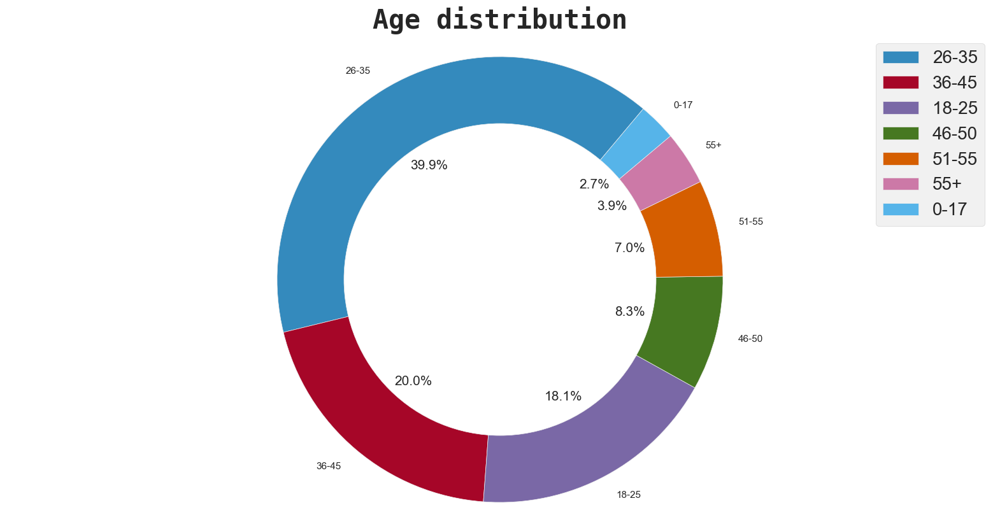

In [20]:
# Creating a donut chart for 'Age'
age = new_df['age'].value_counts()

print("Age counts- \n", age)
plt.style.use('bmh')
plt.figure(figsize = (20, 10))
plt.pie(age.values, labels = age.index, startangle = 50, autopct = '%1.1f%%')
centre_circle = plt.Circle((0, 0), 0.7, fc = 'white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.title('Age distribution', fontdict = {'fontname' : 'Monospace', 'fontsize' : 30, 'fontweight' : 'bold'})
plt.axis('equal')
plt.legend(prop = {'size' : 20})
plt.show()

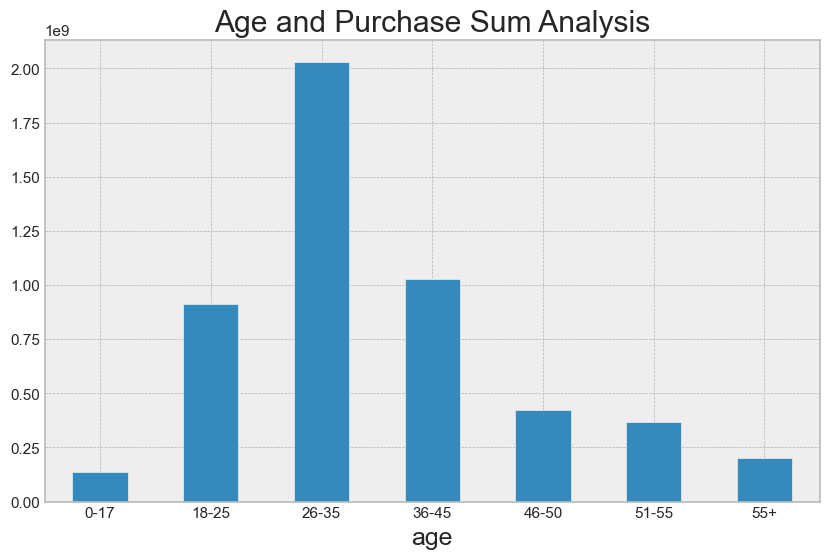

In [32]:
# new_df.groupby("age").sum()['purchase'].plot(kind="bar")
# plt.title("Age and Purchase Sum Analysis")
# plt.xticks(rotation=0)
# plt.show()

stay_in_current_city_years
1     193821
2     101838
3      95285
4+     84726
0      74398
Name: count, dtype: int64


(array([0, 1, 2, 3, 4]),
 [Text(0, 0, '1'),
  Text(1, 0, '2'),
  Text(2, 0, '3'),
  Text(3, 0, '4+'),
  Text(4, 0, '0')])

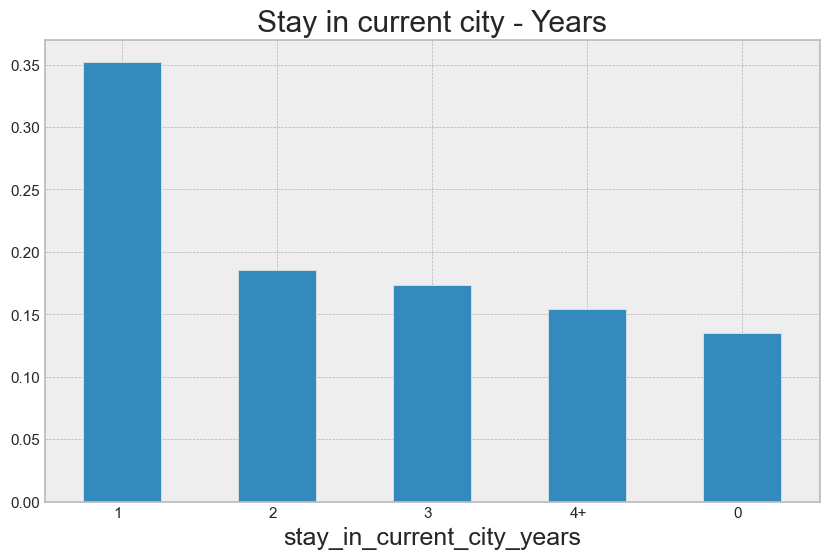

In [21]:
print(new_df["stay_in_current_city_years"].value_counts())
new_df['stay_in_current_city_years'].value_counts(normalize = True).plot.bar(title = 'Stay in current city - Years')
plt.xticks(rotation=0, ha='right')

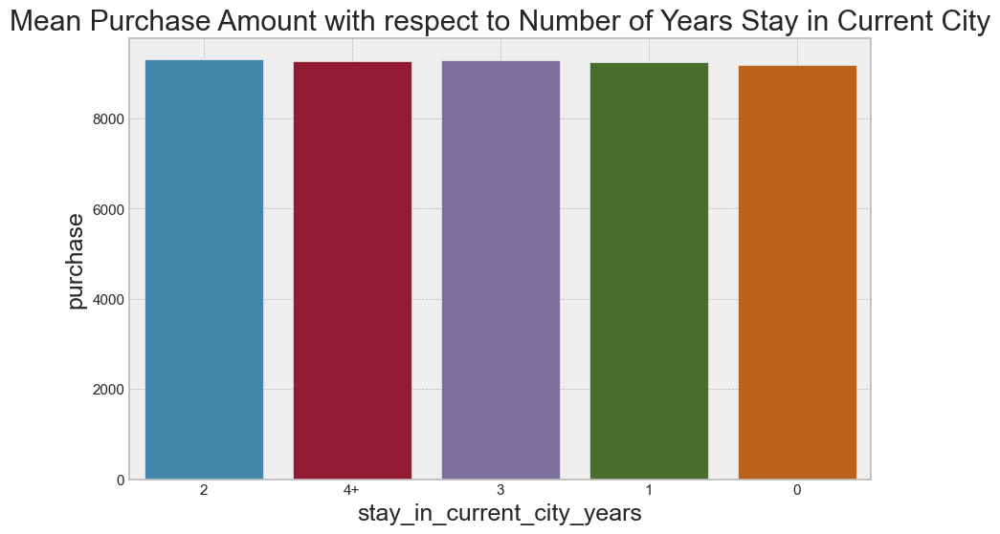

In [45]:
sns.barplot(x='stay_in_current_city_years', y='purchase', data=new_df, ci=None)
plt.title("Mean Purchase Amount with respect to Number of Years Stay in Current City")
plt.grid(1)
plt.show()

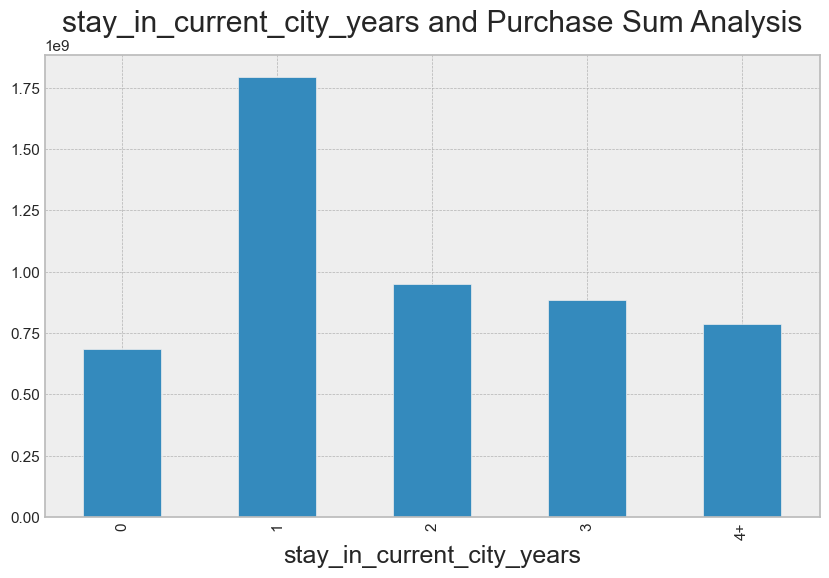

In [35]:
# new_df.groupby('stay_in_current_city_years').sum()['purchase'].plot(kind='bar')
# plt.title("stay_in_current_city_years and Purchase Sum Analysis")
# plt.show()

city_category
A    147720
B    231173
C    171175
dtype: int64


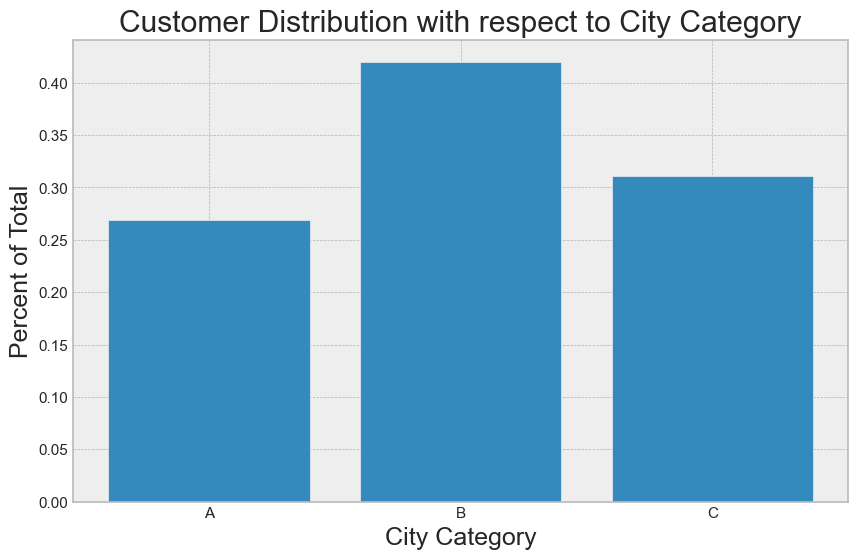

In [22]:
# to visualize the city category with the total data
print(new_df.groupby('city_category').size())
city_category_percent = new_df['city_category'].value_counts(normalize=True).sort_index()
plt.bar(city_category_percent.index, city_category_percent)
plt.title("Customer Distribution with respect to City Category")
plt.xlabel("City Category")
plt.ylabel("Percent of Total")
plt.show()

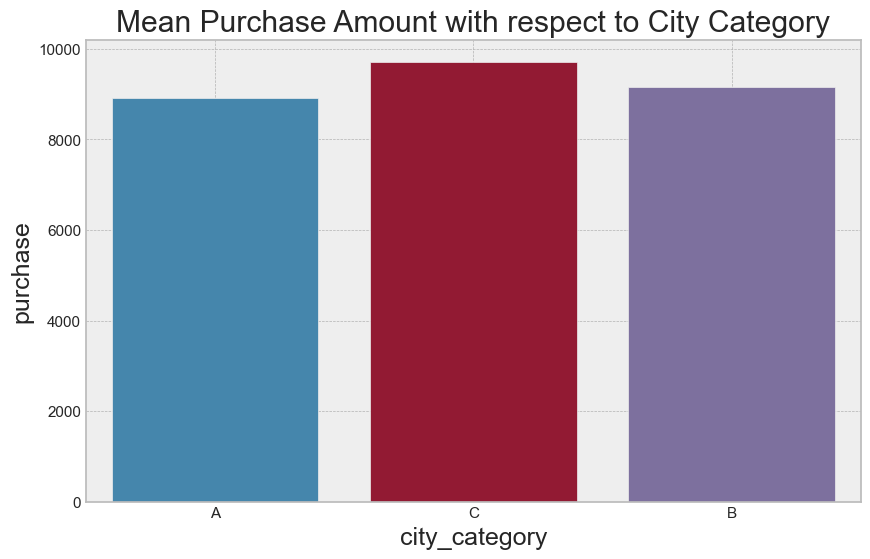

In [44]:
sns.barplot(x='city_category', y='purchase', data=new_df, ci=None)
plt.title("Mean Purchase Amount with respect to City Category")
plt.grid(1)
plt.show()

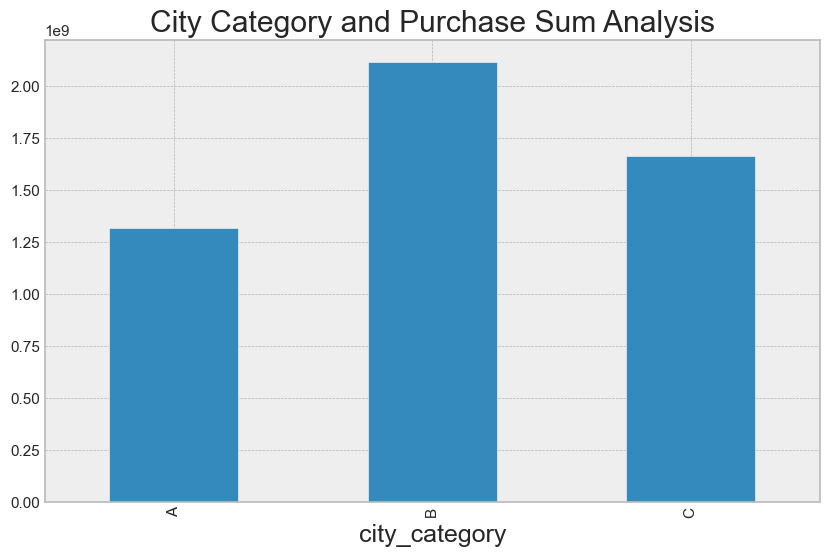

In [38]:
# new_df.groupby('city_category').sum()['purchase'].plot(kind='bar')
# plt.title("City Category and Purchase Sum Analysis")
# plt.xticks(rotation=0)
# plt.show()

<Axes: title={'center': 'City Category'}, ylabel='purchase'>

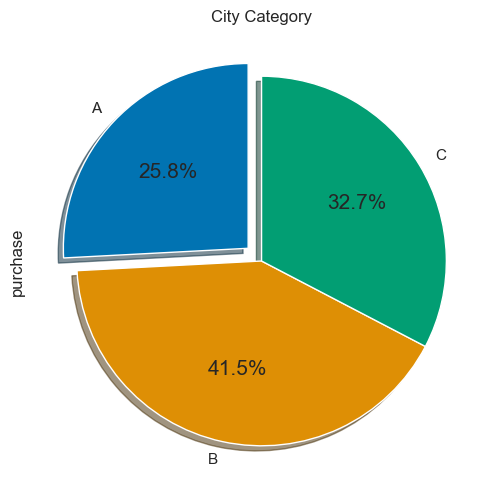

In [ ]:
new_df.groupby("city_category")["purchase"].sum().plot.pie(title = "City Category", startangle = 90, explode = (0.1, 0, 0), autopct = "%1.1f%%", shadow = True)

occupation
0     69638
1     47426
2     26588
3     17650
4     72308
5     12177
6     20355
7     59133
8      1546
9      6291
10    12930
11    11586
12    31179
13     7728
14    27309
15    12165
16    25371
17    40043
18     6622
19     8461
20    33562
dtype: int64


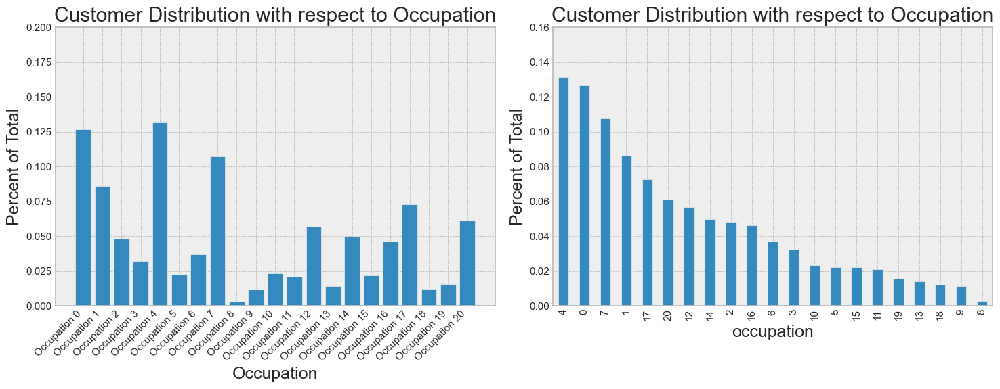

In [23]:
# to visualize the occupation with respect to the data
print(new_df.groupby('occupation').size())
occupation_percent = new_df['occupation'].value_counts(normalize=True).sort_index()

# Create a 1x2 subplot grid
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Plot the first bar plot in the first subplot
occupation_labels = ['Occupation ' + str(occupation) for occupation in occupation_percent.index]
axes[0].set_xticks(occupation_percent.index)
axes[0].set_xticklabels(occupation_labels, rotation=45, ha='right')
axes[0].bar(occupation_percent.index, occupation_percent)
axes[0].set_title("Customer Distribution with respect to Occupation")
axes[0].set_xlabel("Occupation")
axes[0].set_ylabel("Percent of Total")
axes[0].set_ylim(0, 0.2)

ax = new_df['occupation'].value_counts(normalize=True).plot.bar(axes[1], title='Customer Distribution with respect to Occupation')
ax.set_ylabel("Percent of Total")
ax.set_ylim(0, 0.16)
# Show the plots
plt.tight_layout()
plt.show()

* Occupation 8 has extremely low count compared with the others; it can be ignored for the calculation since it won't affect much the result.

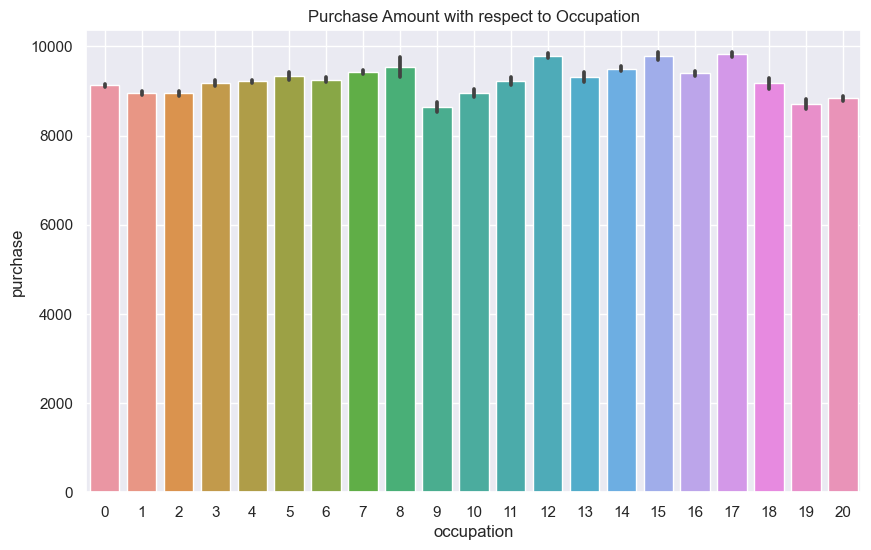

In [ ]:
sns.barplot(x='occupation', y='purchase', data=new_df)
plt.title("Purchase Amount with respect to Occupation")
plt.grid(1)
plt.show()

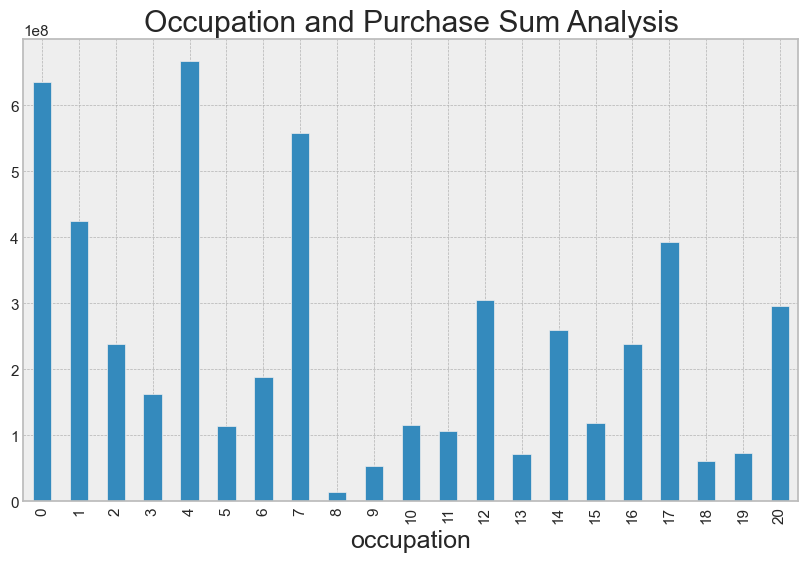

In [31]:
new_df.groupby('occupation').sum()['purchase'].plot(kind='bar')
plt.title("Occupation and Purchase Sum Analysis")
plt.xticks(rotation=0)
plt.show()

marital_status
0    324731
1    225337
Name: count, dtype: int64


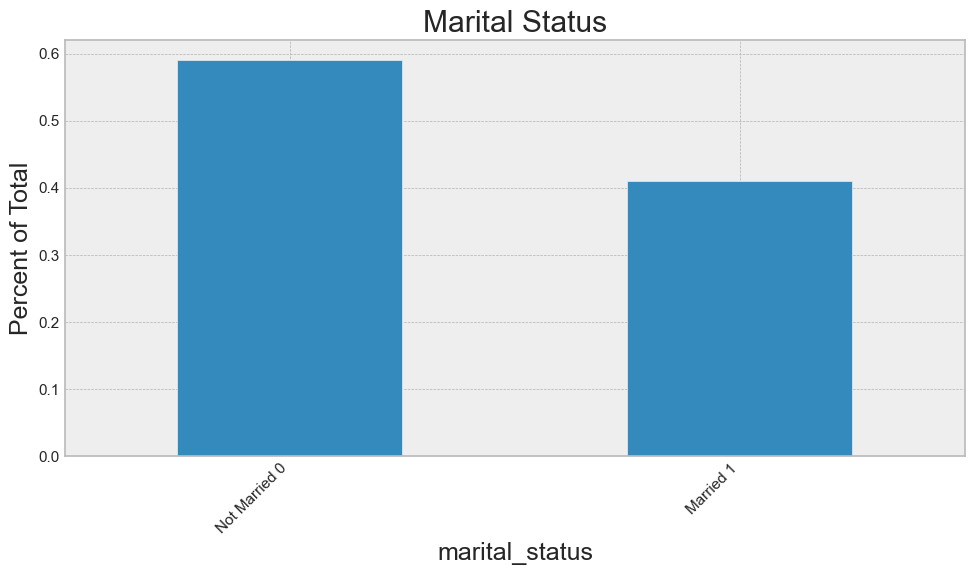

In [24]:
# to visualize the martial relatonship in the data
print(new_df["marital_status"].value_counts())
ax = new_df['marital_status'].value_counts(normalize=True).plot.bar(title='Marital Status')
plt.xticks([0, 1], ['Not Married 0', 'Married 1'], rotation=45, ha='right')
ax.set_ylabel("Percent of Total")
plt.tight_layout()
plt.show()

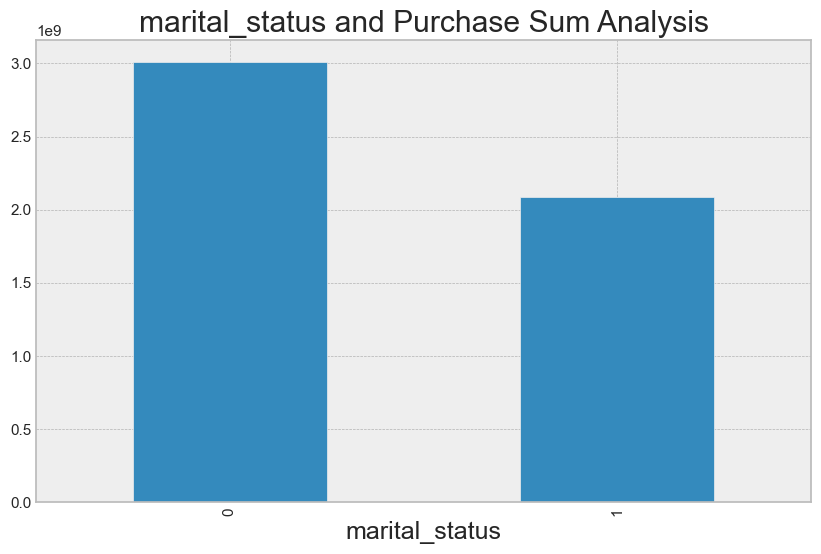

In [36]:
# new_df.groupby('marital_status').sum()['purchase'].plot(kind='bar')
# plt.title("marital_status and Purchase Sum Analysis")
# plt.xticks(rotation=0)
# plt.show()

product_category_1
5     150933
1     140378
8     113925
11     24287
2      23864
6      20466
3      20213
4      11753
16      9828
15      6290
13      5549
10      5125
12      3947
7       3721
18      3125
20      2550
19      1603
14      1523
17       578
9        410
Name: count, dtype: int64


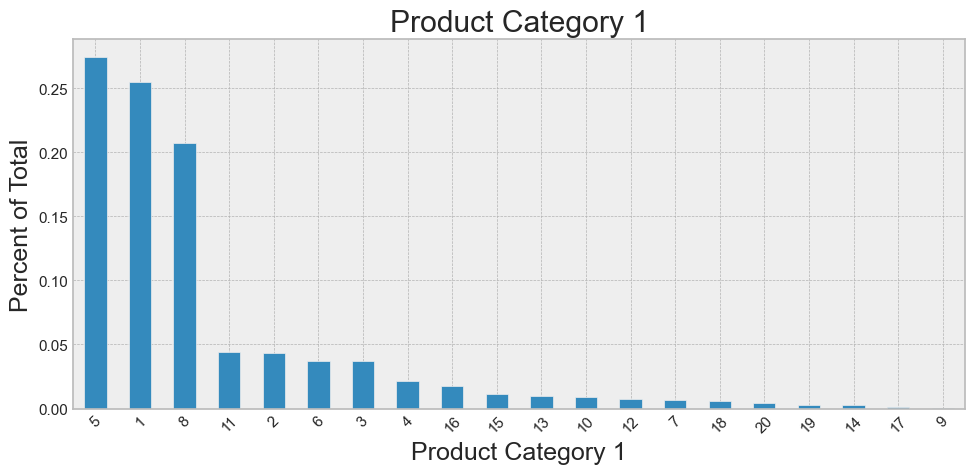

In [25]:
# to visualize the product category 1 data
plt.figure(figsize = (10, 5))
print(new_df["product_category_1"].value_counts())
ax = new_df['product_category_1'].value_counts(normalize=True).plot.bar(title='Product Category 1')
ax.set_xlabel("Product Category 1")
ax.set_ylabel("Percent of Total")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

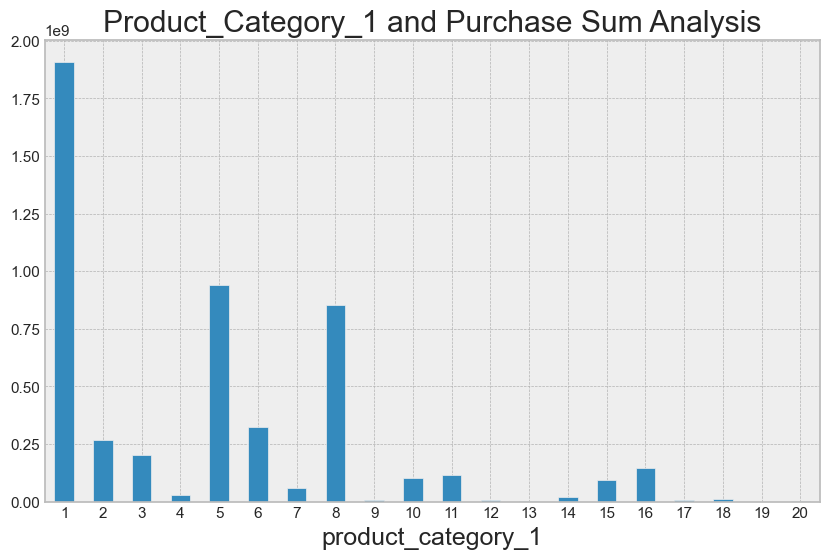

In [43]:
# new_df.groupby('product_category_1').sum()['purchase'].plot(kind='bar')
# plt.title("Product_Category_1 and Purchase Sum Analysis")
# plt.xticks(rotation=0)
# plt.show()

product_category_2
8.0     64088
14.0    55108
2.0     49217
16.0    43255
15.0    37855
5.0     26235
4.0     25677
6.0     16466
11.0    14134
17.0    13320
13.0    10531
9.0      5693
12.0     5528
10.0     3043
3.0      2884
18.0     2770
7.0       626
Name: count, dtype: int64


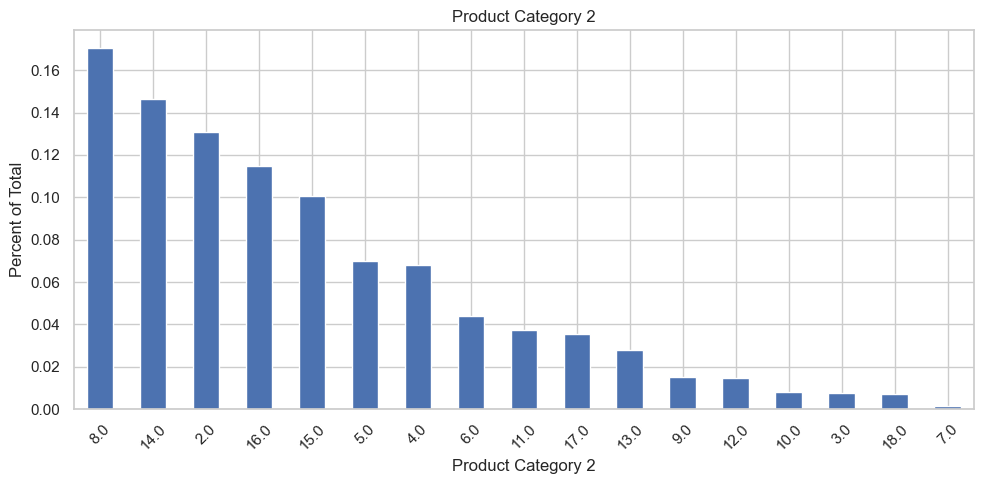

In [ ]:
# to visualize the product category 2 data
plt.figure(figsize = (10, 5))
print(new_df["product_category_2"].value_counts())
ax = new_df['product_category_2'].value_counts(normalize=True).plot.bar(title='Product Category 2')
ax.set_xlabel("Product Category 2")
ax.set_ylabel("Percent of Total")
plt.xticks(rotation=45)
sns.set(style="whitegrid")
plt.tight_layout()
plt.show()

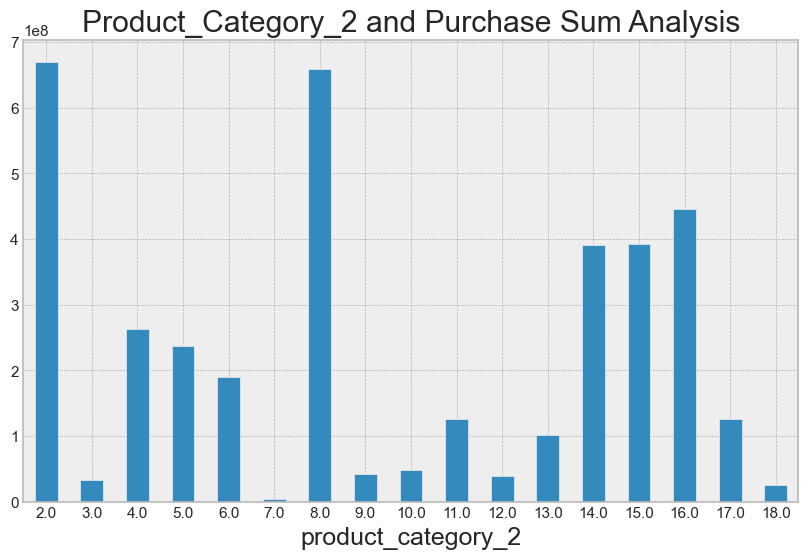

In [42]:
# new_df.groupby('product_category_2').sum()['purchase'].plot(kind='bar')
# plt.title("Product_Category_2 and Purchase Sum Analysis")
# plt.xticks(rotation=0)
# plt.show()

product_category_3
16.0    32636
15.0    28013
14.0    18428
17.0    16702
5.0     16658
8.0     12562
9.0     11579
12.0     9246
13.0     5459
6.0      4890
18.0     4629
4.0      1875
11.0     1805
10.0     1726
3.0       613
Name: count, dtype: int64


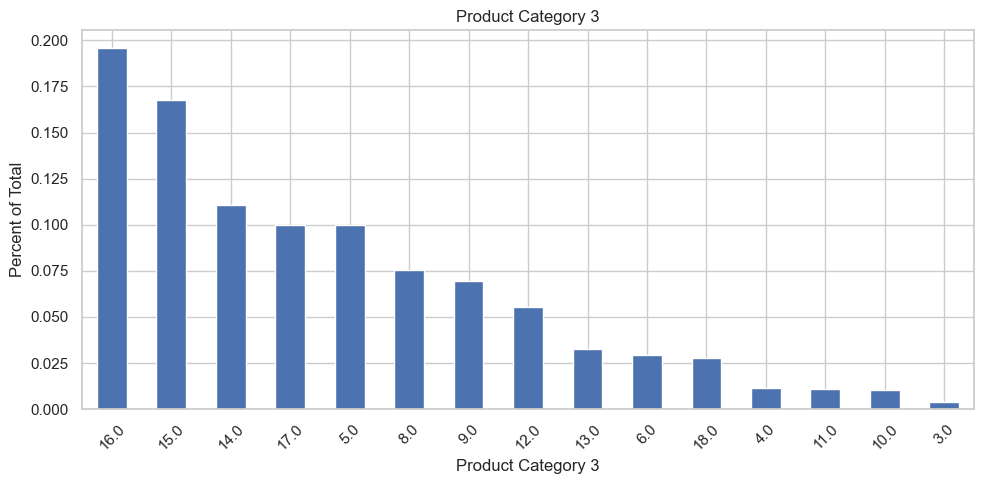

In [ ]:
# to visualize the product category 3 data
plt.figure(figsize = (10, 5))
print(new_df["product_category_3"].value_counts())
ax = new_df['product_category_3'].value_counts(normalize=True).plot.bar(title='Product Category 3')
ax.set_xlabel("Product Category 3")
ax.set_ylabel("Percent of Total")
plt.xticks(rotation=45)
sns.set(style="whitegrid")
plt.tight_layout()
plt.show()

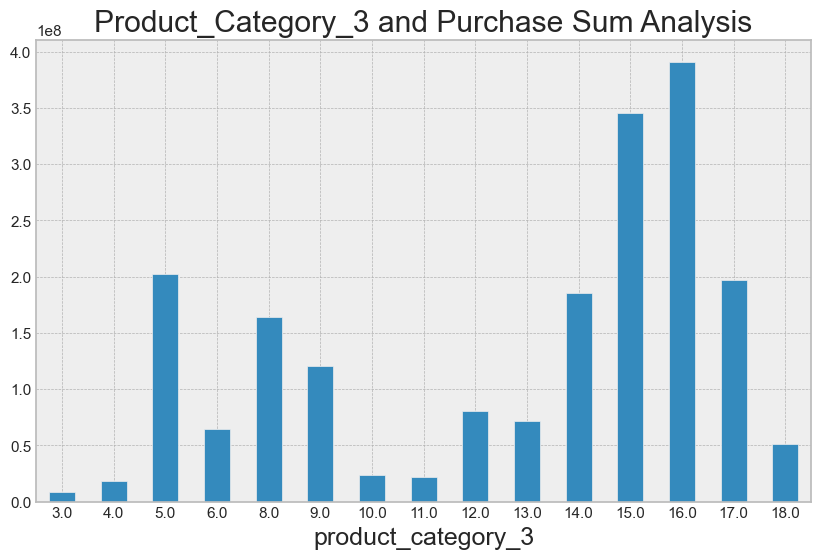

In [41]:
new_df.groupby('product_category_3').sum()['purchase'].plot(kind='bar')
plt.title("Product_Category_3 and Purchase Sum Analysis")
plt.xticks(rotation=0)
plt.show()

### A basic observation is that:

* Product P00265242 is the most popular product.
* Most of the transactions were made by men.
* Age group with most transactions was 26-35.
* City Category with most transactions was B, indicating urban population.
* People living 1 y in city buy the most.
* Unmarried buy more.
* Occupation 4, 0, 7 are the ones that tend to buy most.
* Most loved product under Product_Category_1 is 5, 1 and 8.
* Most loved product under Product_Category_2 is 8.
* Most loved product under Product_Category_3 is 16 and 15.

### filling missing values with 0s and making product category coloumns as type int

In [ ]:
# new_df = new_df.fillna(0)
# new_df[['product_category_2']]=new_df[['product_category_2']].astype(int)
# new_df[['product_category_3']]=new_df[['product_category_3']].astype(int)
# new_df.head()

### Bivariate Analysis

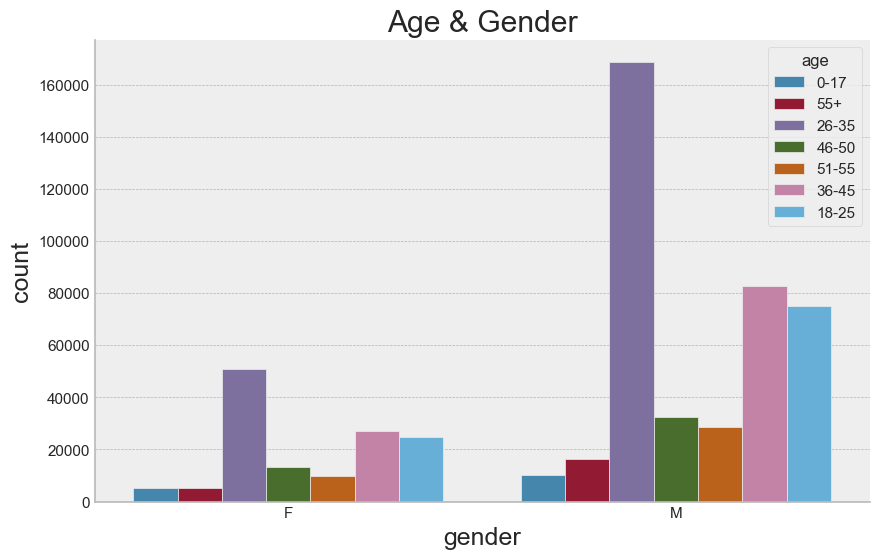

In [54]:
sns.countplot(x=new_df["gender"], hue = new_df["age"]).set_title("Age & Gender")
sns.despine()

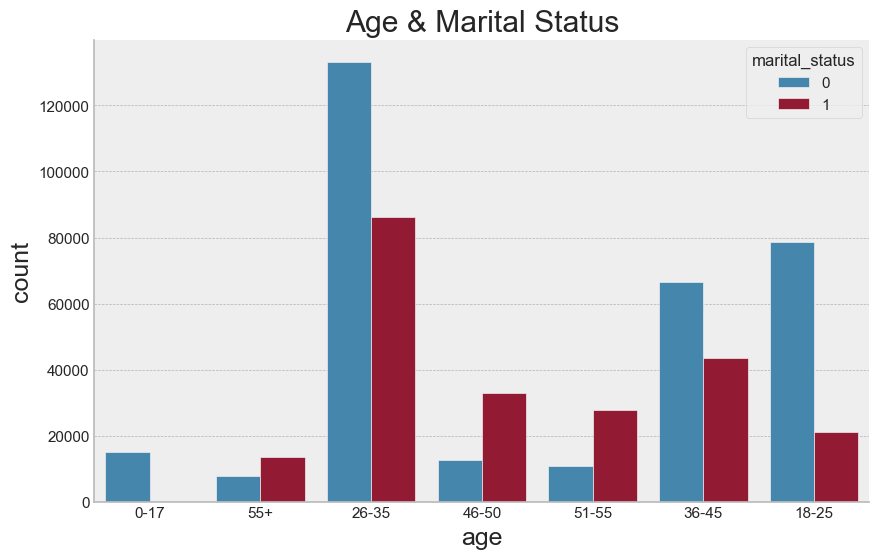

In [53]:
sns.countplot(x=new_df["age"], hue = new_df["marital_status"]).set_title("Age & Marital Status")
sns.despine()

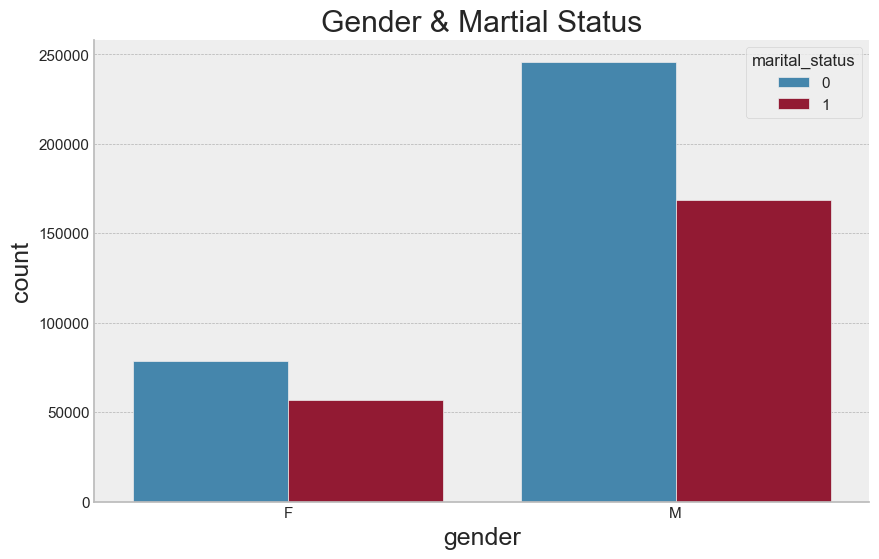

In [50]:
sns.countplot(x=new_df["gender"], hue = new_df["marital_status"]).set_title("Gender & Martial Status")
sns.despine()

<Axes: xlabel='city_category', ylabel='purchase'>

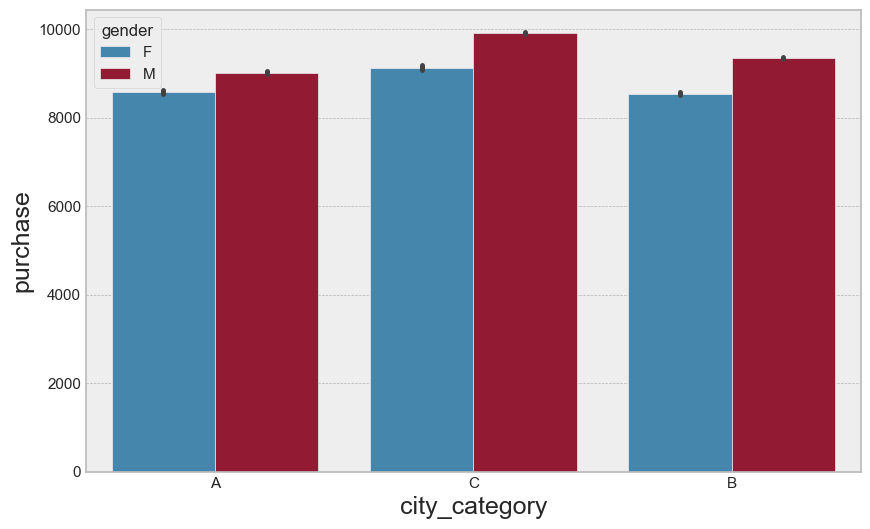

In [56]:
sns.barplot(x = 'city_category', y = 'purchase', hue = 'gender', data = new_df)

<Axes: xlabel='city_category', ylabel='purchase'>

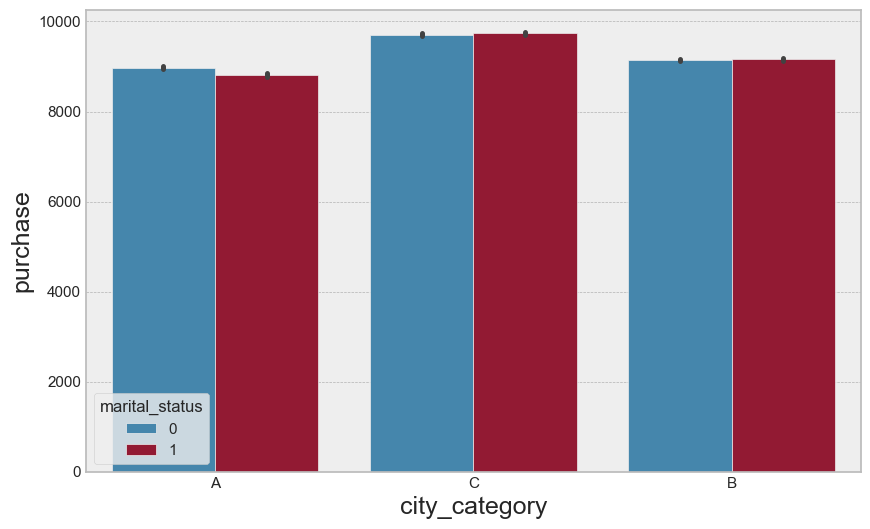

In [57]:
sns.barplot(x = 'city_category', y = 'purchase', hue = 'marital_status', data = new_df)

<Axes: xlabel='occupation', ylabel='purchase'>

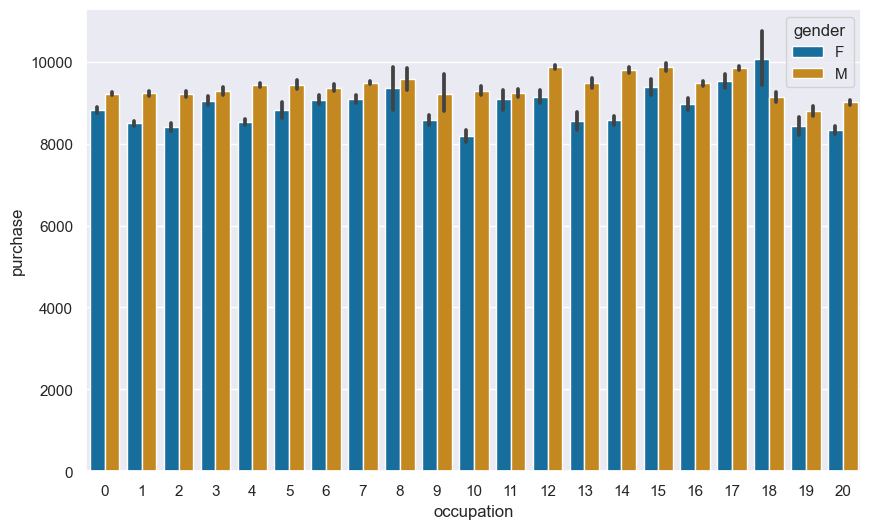

In [ ]:
sns.barplot(x='occupation',y='purchase',hue='gender',data=new_df)


## In this graph it can be seen that the female gender in the occupation 18 with higher purchases compared to others.

<Axes: xlabel='occupation', ylabel='purchase'>

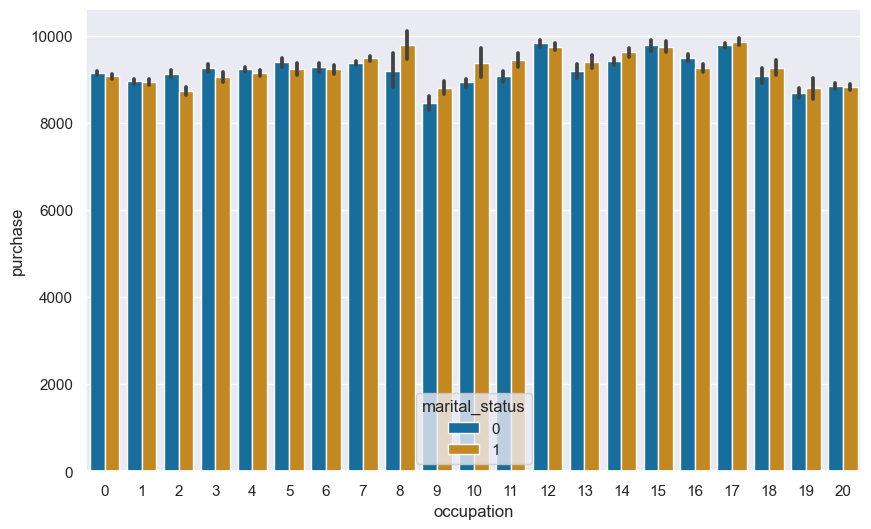

In [ ]:
sns.barplot(x='occupation',y='purchase',hue='marital_status',data=new_df)

## Multivariate Analysis

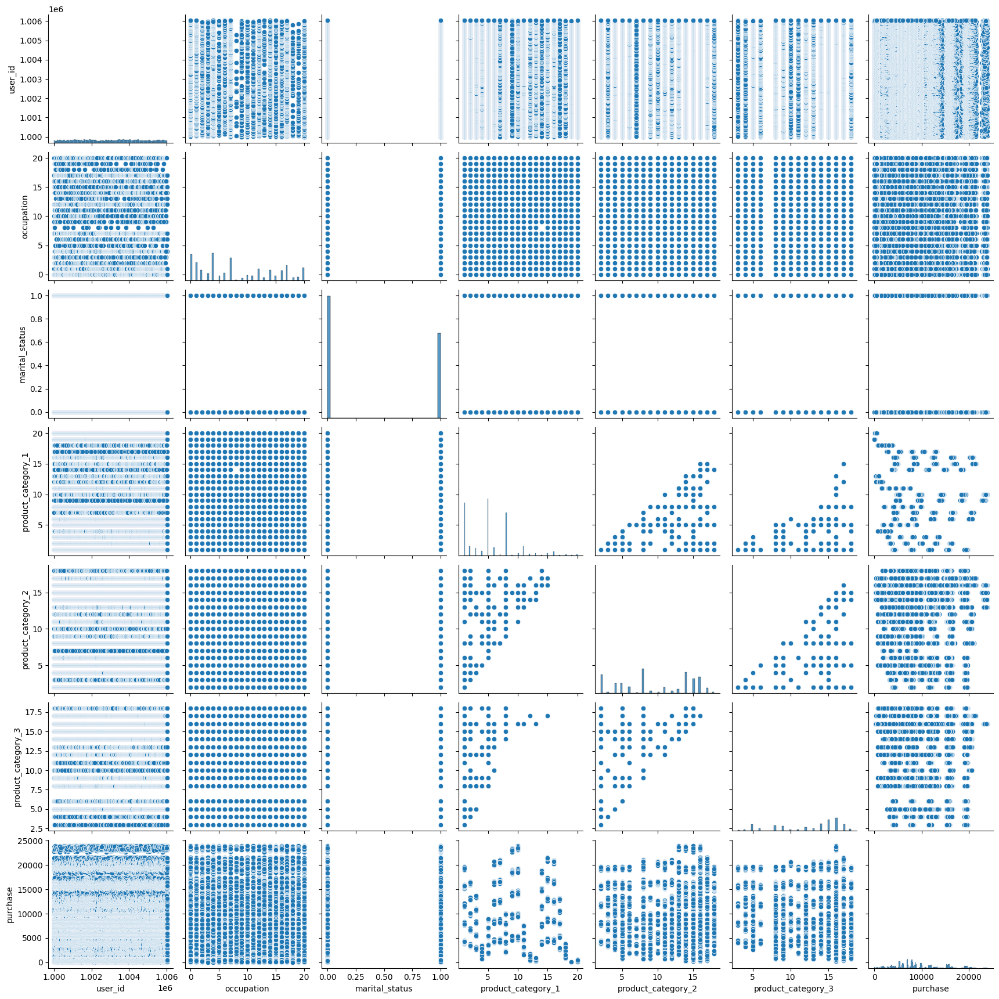

In [58]:
plt.style.use('default')
sns.pairplot(new_df)
plt.show()

### MISSING VALUES AND DATA CLEANING

user_id                        0.000000
gender                         0.000000
age                            0.000000
occupation                     0.000000
product_id                     0.000000
city_category                  0.000000
stay_in_current_city_years     0.000000
marital_status                 0.000000
product_category_1             0.000000
product_category_2            31.566643
product_category_3            69.672659
purchase                       0.000000
dtype: float64


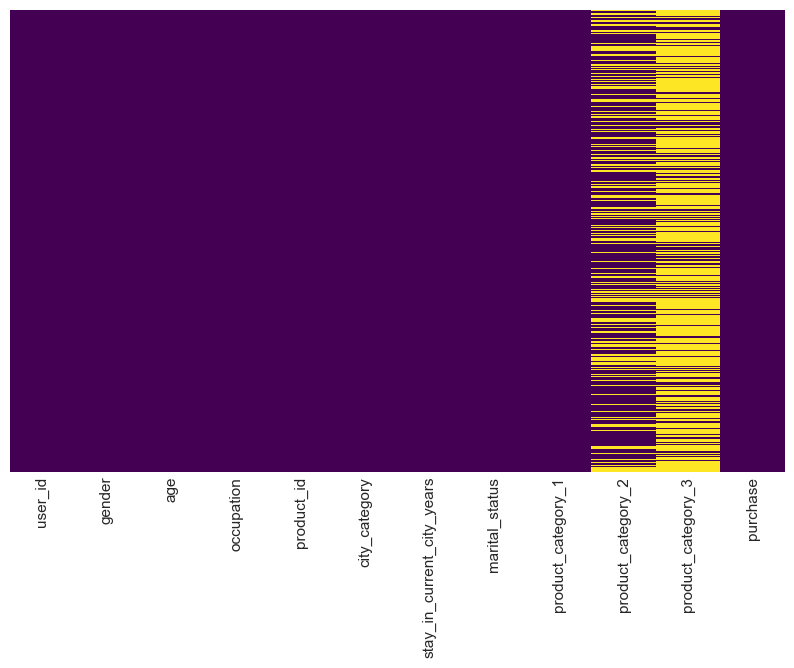

In [ ]:
# to see missing value using visualisation

sns.heatmap(new_df.isnull(), yticklabels=False, cbar=False, cmap='viridis')
percent_missing = new_df.isnull().sum()/new_df.shape[0]*100
print(percent_missing)

In [29]:
x = new_df.groupby(["city_category"]).mean()[["purchase"]].index
y = new_df.groupby(["city_category"]).mean()[["purchase"]].values
plt.plot(x, y,"ro")
plt.title("Mean purchase of different city categories")
sns.despine()

KeyboardInterrupt: 

In [ ]:
plt.figure(figsize = (10, 5))
x = new_df.groupby(["gender"]).mean()[["purchase"]].index
y = new_df.groupby(["gender"]).mean()[["purchase"]].values
plt.plot(x, y,"ro")
plt.xticks(x, ["male", "female"])
plt.title("Mean purchase of different gender")
sns.despine()

TypeError: Could not convert 0-170-170-170-1751-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-350-1751-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3546-5046-500-170-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-350-170-1746-5046-5046-5055+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1718-2518-2518-2518-2536-4536-4536-4526-3526-350-170-170-170-170-1718-2546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1736-4536-4536-4536-4536-4518-2536-4536-4536-4536-4536-4518-2518-2518-250-170-170-1726-3526-3526-3546-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+36-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5018-2546-5046-5051-5551-5551-5546-5018-2518-2518-2536-4536-4536-4536-450-170-1718-2518-2518-2518-2518-2518-2518-250-1736-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3546-5055+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3551-5551-5551-5518-2518-2518-2518-2518-2518-2536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5555+55+55+55+55+55+26-3518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+26-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-1726-3518-2518-2536-4536-4536-4536-4536-4536-450-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-450-170-1736-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-350-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4555+26-3551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+55+55+55+55+55+0-1726-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4518-2518-2526-3526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5055+55+55+55+55+55+36-4551-5551-550-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5051-5551-5551-5555+51-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3536-4536-4536-450-1736-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1718-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-1751-5551-5551-5526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3555+18-2518-2518-2518-2526-3526-3526-3536-4536-450-170-170-170-170-170-1746-5046-5036-4518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-1751-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3518-2518-2518-2546-5046-5026-3526-3526-3518-2518-2518-2518-2518-2518-2551-5551-5551-5526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4526-3526-3536-4518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1755+55+55+26-3526-3526-3526-3551-5546-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5555+55+26-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3555+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5036-4536-4536-4526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4518-2536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4555+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5051-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-450-1718-2551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2518-2518-2518-2518-2551-5551-5518-2536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+26-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5555+55+55+55+36-450-170-1751-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+26-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5026-3551-5551-5526-3526-3551-5551-5551-5551-5555+18-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+46-500-170-170-170-170-1726-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5036-4555+46-5046-5046-5026-3526-3526-3555+55+55+55+55+55+55+55+55+36-4546-5046-5046-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2536-4555+55+46-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-1746-5046-5046-5046-5036-4536-4536-4526-3526-3546-5046-5046-5046-5046-5046-5051-5518-2526-3526-3526-3526-3518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5051-5551-5551-5526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5036-4546-5046-5055+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3526-3526-3555+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+36-4536-4536-4536-4536-4526-3526-3518-2546-5036-4555+46-5046-5055+55+55+51-5551-5551-5555+55+26-3526-3526-3526-3526-3546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2551-5551-5551-5536-4536-4526-3526-3536-4536-4536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+26-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5536-4526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3546-5046-5046-5046-5046-5026-3526-3546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+0-1726-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+18-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-450-170-170-170-170-170-1726-3546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4555+55+55+36-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4555+55+55+55+18-2518-2518-2536-4536-4536-4536-4526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3536-4526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3546-5046-5046-5046-5046-5055+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1736-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-500-170-1746-5046-5046-5046-5055+55+55+36-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2546-5046-5046-5036-4536-4536-4555+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4555+26-3526-3555+26-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3546-5046-5046-5051-5551-5551-5536-4536-4536-4536-450-170-1751-5526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+46-5026-3536-4536-4536-4546-5046-5036-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3536-4551-5551-5536-4536-4536-4546-5046-5046-5046-5026-3536-4536-4518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1726-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4546-5026-3526-3536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+26-3526-3526-3546-5046-5046-5018-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1746-5046-5046-5026-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+26-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3555+55+51-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3546-500-170-1736-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3551-5551-5526-3555+55+55+55+55+46-5046-5046-5046-5055+55+55+26-3555+18-2518-2518-2518-2518-2555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+46-5036-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5026-3526-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2551-5551-5536-4536-4518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-1726-3526-3555+26-3526-3526-3526-3551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-500-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3555+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4546-5046-5036-4536-4536-4555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-1755+55+36-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-170-170-170-170-170-170-170-170-170-1751-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2551-5551-5526-3526-3526-3536-4536-4526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-350-170-170-1751-5551-5551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2551-5551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3551-5551-5551-5551-5526-3526-3526-3536-4526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-170-170-1755+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1751-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-1736-4546-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3536-4526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4518-2518-2518-2518-2546-5026-3526-3546-5046-5046-5046-5018-2518-2518-2555+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2555+55+55+55+0-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-350-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-1751-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3546-5046-5046-500-170-170-170-170-170-170-170-170-170-170-1746-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-1746-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-450-170-1718-2518-2518-2518-2518-2536-4526-3526-3526-3526-350-170-170-170-170-1718-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2555+51-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5026-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-1736-4536-4536-4518-2518-2536-4536-4536-4536-4536-4518-2518-2518-250-170-170-1726-3546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5555+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+36-4518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2536-4536-4536-4526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3546-5046-5018-2518-2518-2551-5546-5046-5046-5018-2518-2518-2536-4536-4536-4536-450-170-1718-2518-2518-2518-2518-2518-2518-250-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3546-5046-5055+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5555+55+55+26-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+26-3526-3526-3518-2518-250-170-1726-3526-3526-3518-2536-4536-450-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5051-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-350-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4555+55+55+26-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4546-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3536-4555+55+55+55+55+55+55+0-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+46-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5026-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3536-4518-2526-3526-3536-4536-4546-5046-5046-5046-5046-5055+55+55+55+55+55+55+55+55+36-450-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3546-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+51-5551-5551-5551-5551-5551-5551-5526-3518-2518-2518-2518-2546-5026-3526-3536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-1726-3526-3551-5551-5551-5526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5055+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+18-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1736-4536-4518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-1751-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3546-5046-5026-3526-3526-3518-2518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4526-3526-3536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1755+55+51-5551-5546-5046-5046-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5055+55+55+55+26-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4555+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-450-170-170-170-170-170-170-170-170-1718-2518-2518-2551-5546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2518-2518-2518-2551-5551-5536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+26-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5555+55+55+55+55+36-450-1751-5555+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5051-5526-3551-5555+55+55+18-2555+55+55+55+55+55+55+55+55+46-5046-500-170-170-170-1726-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4555+46-5026-3555+55+55+55+55+55+36-4536-4551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3518-2518-2518-2518-2536-4536-4555+55+46-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+0-170-170-170-170-1736-4526-3526-3526-3526-3526-3526-3546-5046-5046-5051-5518-2518-2518-2526-3526-3546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5018-2518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4546-5046-5036-4536-4546-5046-5046-5046-5055+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3526-3526-3526-3551-5551-5555+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4526-3526-3518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4555+55+55+46-5046-5046-5046-5055+55+55+51-5555+55+55+55+26-3526-3526-3526-3526-3526-3526-3546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5526-3526-3526-3526-3555+55+55+26-3526-3518-2551-5551-5551-5551-5526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-550-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3555+55+51-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+36-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5026-3526-3546-5026-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+18-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1736-4536-4526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5036-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5055+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1736-4536-4546-5046-5046-5046-5046-5055+55+55+36-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5036-4555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4555+26-3526-3555+55+26-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3546-5046-5046-5046-5046-5026-3526-3536-4536-4536-450-1751-5551-5526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3555+55+55+46-5046-5026-3526-3526-3526-3526-3526-3536-4536-4536-4536-4546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3551-5551-5536-4546-5046-5046-5046-5046-5046-5046-5046-5026-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-450-1736-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5026-350-170-170-1736-4536-4536-4536-4536-4526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+26-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-450-170-170-170-1746-5046-5026-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4555+55+55+36-4536-4536-4536-4536-4536-4536-4555+55+55+26-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2555+51-5551-5551-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2536-4536-4551-5536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5546-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2546-5051-5551-5551-5551-5551-5518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3526-3526-3536-4546-5046-500-170-170-1736-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3551-5526-3526-3526-3555+55+55+55+55+55+55+55+46-5046-5046-5046-5055+55+55+26-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3555+55+46-5036-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5026-3526-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4518-2536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-1726-3555+55+55+55+26-3526-3551-5551-5551-5551-5518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-500-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3518-2518-2518-2536-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3555+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4546-5046-5036-4536-4536-4536-4536-4536-4536-4555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-250-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3555+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-1755+55+55+36-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5036-4536-4536-4536-4536-4536-4518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4546-5046-500-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-170-170-170-1751-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2551-5551-5551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-1736-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1751-5551-5551-5551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3518-2518-2518-250-170-1718-2518-2518-2526-3526-3526-3526-3536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-170-170-170-1755+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-550-170-1736-4536-4536-4536-4536-4536-4536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4518-2536-4546-5036-4536-4518-2518-2518-2518-2546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2546-5026-3526-3526-3546-5046-5046-5046-5018-2518-2518-2536-4536-4555+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2555+55+55+55+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-350-170-170-1751-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3546-5046-500-170-170-170-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-1718-2518-2518-2518-2536-4536-4536-4526-3526-3526-3526-3526-350-170-170-1718-2518-2546-5046-5046-5046-5046-5046-5026-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2555+55+26-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2546-5026-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1736-4536-4518-2536-4536-4536-4536-4518-2518-2518-2518-250-170-1718-2518-2526-3526-3526-3551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5046-5051-5546-5046-5046-5046-5018-2518-2518-2518-2536-4536-4536-4536-450-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-250-1736-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5055+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5555+55+55+55+55+55+26-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3518-2518-250-170-170-170-1726-3526-3526-3536-4536-4536-4536-450-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-450-170-170-1736-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5051-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+55+26-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4546-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3526-3526-3526-3536-4555+55+55+0-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5055+55+51-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5051-5551-5551-5551-5551-5551-5555+55+51-5551-5518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-1751-5551-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-1718-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+51-5551-5551-5551-5518-2518-2518-2546-5046-5046-5046-5026-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+46-5046-5046-5046-5046-5046-5046-5046-5018-2518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3546-5046-500-170-170-170-1726-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5055+46-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+18-2518-2526-3526-3526-3536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-1746-5046-5046-5018-2518-2518-2518-250-170-170-170-170-170-170-170-1751-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5046-5026-3526-3518-2546-5046-5026-3526-3526-3518-2518-2546-5026-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-170-170-170-1755+55+55+55+55+55+26-3526-3526-3526-3526-3551-5546-5046-5046-5046-5018-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5055+55+55+55+26-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4555+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4555+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4546-500-170-170-170-1718-2518-2518-2551-5551-5551-5551-5546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4518-2551-5536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+26-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5555+46-500-170-170-1751-5551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5555+55+55+18-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-500-170-1726-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5051-5555+55+55+55+55+46-5046-5026-3555+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4546-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2518-2536-4555+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1746-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3546-5036-4546-5051-5551-5518-2526-3526-3526-3518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5018-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4546-5046-5055+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3551-5551-5555+55+55+46-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+36-4536-4536-4536-4536-4526-3526-3518-2546-5036-4536-4536-4555+55+55+46-5046-5046-5046-5046-5026-3526-3526-3555+55+55+55+51-5555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5536-4536-4526-3536-4536-4536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3526-3555+55+55+55+26-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5026-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-550-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+0-1726-3526-3526-3551-5518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+18-2518-2526-3526-3526-3526-3518-2536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1726-3526-3526-3526-3546-5046-5046-5046-5026-3546-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+36-4526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1726-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5036-4536-4536-4526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5536-4551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5046-5055+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1736-4546-5046-5046-5046-5046-5046-5046-500-170-1746-5046-5055+55+55+55+55+36-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5036-4536-4536-4555+26-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-450-1751-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2536-4551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+55+55+46-5046-5046-5026-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3536-4551-5536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-450-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+26-3546-5018-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2526-3536-4536-4536-4536-450-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-1746-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+26-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+51-5551-5551-5551-5526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2546-5051-5551-5551-5551-5518-2518-2536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4526-3536-4546-500-1736-4536-4536-4555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3546-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+55+55+55+55+46-5046-5046-5046-5046-5046-5055+55+26-3518-2518-2518-2555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5046-5046-5046-5036-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2551-5551-5536-4518-2518-2518-2518-2518-2518-2518-250-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-1755+55+55+36-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4546-5046-500-1726-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1751-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5051-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1726-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-1751-5551-5551-5551-5526-3526-350-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2536-4536-4551-5551-5551-5551-5526-3546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2536-4518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4526-3526-3518-2518-2518-250-170-1718-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-250-170-170-170-170-170-170-1755+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1751-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-550-170-1736-4536-4536-4536-4536-4536-4536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5026-3518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3546-5018-2518-2536-4536-4536-4555+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+55+55+55+55+55+55+55+0-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-1751-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-350-1736-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-350-170-1746-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2536-4526-3526-3526-3526-350-170-170-170-170-1718-2546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2555+55+55+55+26-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2546-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-1736-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2526-3546-5046-5046-5046-5051-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+26-3518-2518-2518-2518-2518-2518-2518-2536-4536-4518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4526-3536-4526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5051-5546-5018-2518-2518-2518-2518-2536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-250-1736-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5555+55+55+55+55+55+26-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3518-2518-2518-2518-2518-2518-2518-2518-250-1736-450-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-450-170-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-350-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4555+55+55+55+55+55+26-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4546-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+55+55+55+0-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+46-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5026-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2526-3526-3526-3526-3526-3536-4536-4546-5046-5046-5046-5046-5046-5055+55+55+55+55+55+55+36-4536-4536-4536-4551-550-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+46-5046-5051-5555+55+55+55+51-5518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-450-1736-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-1718-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3536-4536-4536-4526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5018-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-250-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-350-1726-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5046-5036-4518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-1751-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3546-5046-5046-5026-3526-3526-3518-2518-2518-2518-2546-5051-5526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-1755+55+55+55+55+26-3526-3551-5551-5546-5018-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+26-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5036-450-170-170-170-170-1718-2518-2551-5551-5551-5551-5546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1718-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-450-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3555+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-450-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+26-3546-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5555+55+55+0-170-1751-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5555+55+55+55+18-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-500-1726-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5051-5536-4555+46-5046-5046-5026-3526-3555+55+55+55+55+55+55+55+55+55+36-4536-4546-5046-5046-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4555+55+46-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+0-170-1751-5546-5046-5026-3526-3526-3526-3526-3546-5046-5046-5036-4546-5046-5051-5551-5518-2518-2526-3526-3526-3518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5018-2551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4546-5046-5046-5036-4536-4536-4546-5055+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5555+46-5046-5046-5046-5036-4536-4536-4536-4536-4546-5036-4555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5046-5036-4536-4536-4555+55+55+55+55+46-5046-5026-3555+55+55+51-5555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5526-3555+55+26-3526-3526-3526-3526-3518-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2526-3518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4551-5551-5526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+0-170-1751-5551-5518-2536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+18-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3546-5026-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4555+55+55+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4555+55+55+18-2518-2518-2536-4536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1726-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-1746-5036-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2551-5536-4536-4551-5518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5046-5046-5046-5046-5055+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1746-5046-5046-5055+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2546-5046-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4555+55+55+26-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5051-5551-5551-5551-5551-5536-4526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+55+46-5026-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5026-3536-4518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-550-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1726-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-1726-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+26-3526-3526-3546-5046-5018-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2555+18-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5036-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-450-170-170-1746-5046-5046-5046-5046-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+18-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2555+55+55+51-5551-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2546-5046-5051-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4546-500-1736-4536-4536-4555+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3555+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5055+55+55+55+55+26-3518-2518-2518-2555+55+26-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+18-2518-2546-5036-4536-4536-4555+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5026-3526-3526-3555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2551-5536-4518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3526-3526-3526-3526-3551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-500-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-500-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-170-170-170-170-170-1751-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2551-5551-5551-5526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-1726-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2551-5526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-350-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4551-5551-5551-5551-5526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3551-5551-5551-5551-5526-3526-3536-4536-4526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4526-3518-2518-2518-2518-2518-2518-250-1718-2518-2518-2518-2526-3526-3536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-250-170-1755+55+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1751-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-550-170-170-170-170-1736-4536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4555+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+55+55+55+55+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-350-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5055+46-5046-5046-5046-500-170-170-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-350-170-1751-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3546-500-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1746-5046-5046-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-450-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4526-3526-3526-350-170-170-170-170-1718-2546-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2555+55+26-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-1736-4518-2518-2518-2518-2518-2518-2518-2518-250-170-1726-3526-3526-3526-3526-3546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+26-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+36-4526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4536-4518-2518-2536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2546-5051-5551-5551-5551-5551-5551-5546-5046-5036-4536-4518-2536-4536-450-170-1718-2518-2518-2518-250-1726-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5055+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2536-4546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3518-2518-250-170-1726-3518-2536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-450-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-350-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4555+55+55+55+26-3526-3551-5551-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4546-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4555+55+0-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+46-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5055+55+36-4551-5551-5551-550-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5046-5046-5046-5051-5551-5551-5551-5551-5555+51-5551-5518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-450-170-170-170-170-1736-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+51-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-250-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3546-500-170-170-1726-3551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5055+46-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+18-2518-2526-3526-3536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-1746-5046-5046-5018-250-170-170-170-170-170-170-170-170-170-1751-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5026-3518-2518-2546-5046-5046-5026-3526-3546-5051-5551-5551-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1726-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-170-170-170-1755+55+26-3526-3551-5551-5551-5551-5546-5046-5046-5046-5046-5018-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5055+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4555+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5051-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-450-170-170-170-1718-2551-5551-5551-5551-5546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1718-2518-2518-2518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-450-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2551-5536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5555+55+55+55+55+55+55+46-5046-500-170-1755+55+55+55+55+55+55+55+18-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-500-170-1726-3526-3526-3526-3536-4536-4536-4536-4546-5046-5051-5536-4555+55+55+46-5046-5046-5046-5026-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4546-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2555+55+55+55+46-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+0-170-170-170-170-1751-5546-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4546-5046-5046-5051-5518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4546-5036-4536-4536-4536-4555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5055+55+26-3526-3526-3526-3526-3526-3526-3526-3551-5551-5555+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+46-5046-5046-5046-5055+55+55+55+55+51-5551-5551-5551-5555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3536-4536-4536-4536-4536-450-170-170-1726-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-1726-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5026-3536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-550-170-170-170-170-170-170-170-170-1726-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+51-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+26-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+36-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1726-3526-3546-5046-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+18-2518-2518-2518-2536-4536-4526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-1746-5046-5036-4536-4536-4536-4536-4536-4526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+36-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5536-4536-4536-4551-5518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5055+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1736-4546-5046-5046-5046-5046-5046-5046-5046-500-1746-5046-5046-5046-5046-5046-5046-5055+55+36-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4555+55+26-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3551-5551-5551-5536-4536-4536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3555+55+46-5026-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3536-4536-4536-4536-4551-5551-5551-5536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4546-5046-5026-3526-3526-3526-3526-350-1718-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3526-3526-3526-3526-3546-5046-5026-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2536-4536-4536-4536-4536-4536-450-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2555+18-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1746-5046-5046-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2555+55+51-5551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2536-4536-4551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2546-5046-5051-5551-5551-5551-5551-5551-5551-5551-5518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3536-4546-500-1736-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5055+55+26-3526-3526-3526-3526-3526-3555+18-2555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2546-5046-5046-5046-5036-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5026-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-250-170-170-170-170-1726-3526-3555+26-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3518-2518-2518-2518-2518-2518-2518-2518-2536-4551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4555+55+55+55+55+55+26-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-250-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-1755+55+55+36-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+36-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3536-4526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-500-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-250-170-170-170-170-170-170-1751-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5551-5551-5551-5551-5526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3551-5551-5526-3526-3526-3536-4526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3518-2518-2518-2518-250-170-170-170-170-1718-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-1755+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1751-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-550-170-1736-4536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2546-5046-5026-3546-5046-5046-5018-2518-2536-4555+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2555+55+55+0-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-350-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5055+46-5046-500-170-1751-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-350-170-170-1736-4551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3546-5046-500-170-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-350-1746-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-350-170-170-170-1718-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2555+51-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-1736-4536-4518-2518-2518-250-170-170-170-170-170-1726-3526-3526-3546-5051-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4518-2536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4526-3526-3526-3526-3518-2526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4526-3546-5046-5018-2518-2518-2551-5551-5551-5536-4536-4518-2518-2518-2518-2536-4536-450-170-170-170-1718-2518-2518-2518-250-170-1736-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2546-5055+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5518-2518-2518-2518-2518-2518-2536-4546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2518-250-170-1726-3518-2536-4536-4536-4536-450-170-170-170-170-170-170-170-170-1736-4536-450-170-170-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5051-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-350-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4555+55+55+26-3551-5526-3526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3526-3526-3536-4536-4555+55+55+55+55+55+55+55+55+0-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+46-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3551-5551-5551-5546-5046-5026-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4546-5046-5046-5055+55+55+55+55+55+55+55+55+51-550-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3546-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+46-5051-5551-5551-5555+55+55+55+55+55+18-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1718-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2546-5026-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5018-2518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1736-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-350-170-1726-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2518-2518-2526-3526-3536-4536-4536-4536-450-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5036-4536-4536-4518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1751-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+46-5046-5046-5046-5046-5026-3526-3518-2518-2518-2546-5051-5551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-250-1755+55+55+26-3551-5551-5546-5018-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5055+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2526-3518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5051-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5036-450-1718-2518-2518-2551-5551-5546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1718-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-450-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5555+55+36-4536-4546-500-170-1751-5555+55+55+55+55+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5526-3551-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-500-1726-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5051-5551-5536-4555+55+55+55+46-5046-5046-5046-5055+55+55+55+55+55+55+55+55+55+55+36-4546-5046-5051-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5026-3555+55+55+18-2536-4536-4536-4536-4555+55+55+55+55+46-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+0-170-170-1751-5546-5036-4536-4526-3526-3526-3526-3536-4546-5046-5046-5046-5046-5046-5046-5051-5551-5518-2518-2526-3526-3518-2551-5551-5546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5018-2518-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4546-5046-5046-5036-4555+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3551-5551-5555+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5055+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2546-5046-5046-5036-4536-4536-4536-4536-4555+55+55+46-5026-3555+55+55+51-5551-5551-5555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3551-5551-5536-4536-4526-3536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3526-3555+55+26-3526-3518-2551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-550-170-170-170-170-170-170-1726-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+51-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+18-2536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1726-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4555+18-2518-2536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4536-4536-4536-4536-4526-3551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3536-4536-4536-4536-4536-450-1746-5046-5046-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5555+36-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3546-5055+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4546-5046-5046-5046-500-170-170-1746-5046-5046-5046-5046-5055+55+55+55+55+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5055+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4555+26-3526-3526-3526-3555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3546-5046-5046-5026-3551-5536-4536-4551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+46-5046-5026-3526-3526-3536-4536-4536-4536-4536-4526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3551-5536-4536-4546-5046-5046-5046-5046-5046-5026-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-450-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5026-3526-3526-350-1736-4526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+46-5046-5026-3518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+18-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4546-5046-5026-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+26-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5546-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5518-2526-3526-3526-3536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4526-3536-4536-4536-4536-450-170-170-1736-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5536-4536-4526-3526-3551-5526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3551-5526-3555+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5055+55+55+55+55+55+26-3526-3526-3526-3518-2518-2518-2518-2555+55+26-3526-3526-3526-3526-3526-3526-3555+18-2546-5046-5046-5036-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5026-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3555+55+26-3526-3551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4546-5036-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-250-170-170-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1755+55+55+36-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4546-500-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-250-170-170-170-170-170-170-1751-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2551-5526-3526-3526-3536-4526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5551-5526-3526-350-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2536-4536-4551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3551-5526-3536-4536-4536-4526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4526-3518-2518-2518-2518-250-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-250-170-1755+55+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1751-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-550-170-1736-4536-4536-4536-4536-4536-4536-4546-5026-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4518-2536-4546-5036-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2546-5046-5046-5026-3546-5046-5046-5055+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2555+0-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5055+46-5046-5046-5046-5046-5046-500-170-170-1751-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-350-170-170-170-1751-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3526-350-170-170-170-1746-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1746-5046-5055+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1718-2518-2536-4536-4526-3526-3526-3526-350-170-170-170-170-1718-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2555+26-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1718-2518-2536-4536-4536-4518-2518-2518-2518-250-170-170-170-170-1726-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+26-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+36-4536-4536-4526-3536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4526-3526-3536-4536-4526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5051-5551-5546-5046-5036-4518-2518-2518-2518-2518-2536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5518-2518-2536-4536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5555+55+55+55+55+26-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3526-3518-2518-2518-2518-250-1726-3518-2518-2536-4536-450-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-450-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-350-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4555+55+55+55+26-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4546-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3555+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5055+55+55+55+36-4536-4551-5551-5551-550-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2555+46-5046-5046-5046-5046-5051-5551-5551-5555+51-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-450-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1718-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+51-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+46-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-170-1736-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-500-170-170-1726-3551-5526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5055+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-1746-5046-5036-4518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-1751-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5026-3518-2518-2518-2518-2546-5026-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-1755+55+55+55+55+55+55+55+26-3526-3526-3526-3551-5546-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5055+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4555+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-500-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4546-500-170-170-170-170-1718-2518-2551-5551-5551-5546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2518-2518-2518-2518-2518-2551-5551-5518-2518-2536-4536-4536-4536-4536-450-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5026-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4536-4518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5555+36-4536-4546-500-170-1751-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5051-5551-5526-3526-3526-3551-5555+18-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-500-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5036-4555+26-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4546-5046-5046-5051-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2518-2536-4536-4536-4536-4536-4536-4555+55+46-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1751-5546-5046-5046-5046-5036-4536-4526-3526-3526-3526-3536-4546-5046-5046-5046-5051-5518-2518-2526-3526-3518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5036-4546-5055+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5055+55+26-3526-3551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+36-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4546-5046-5026-3526-3551-5551-5551-5555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+55+55+55+55+26-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5018-2518-2551-5536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5518-2518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+51-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+18-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1746-5046-5046-5046-5046-5046-5026-3546-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4555+55+55+36-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4555+55+55+18-2518-2518-2518-2536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-450-170-1746-5036-4536-4526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+36-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5536-4536-4536-4536-4551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4546-5046-5055+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4546-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1746-5046-5046-5055+55+55+55+55+36-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2546-5046-5046-5046-5046-5036-4536-4555+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5546-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4526-3555+26-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3551-5551-5551-5536-4551-5526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3555+55+46-5026-3526-3526-3526-3526-3536-4526-3526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5536-4536-4546-5046-5046-5026-3526-3526-3526-3536-4518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3536-4536-4526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+26-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+55+18-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5036-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-450-170-1746-5046-5026-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+26-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2555+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2526-3536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2546-5051-5551-5551-5551-5518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-450-170-1736-4536-4536-4536-4536-4536-4555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3551-5555+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5055+55+55+55+55+26-3526-3526-3526-3526-3526-3518-2555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+46-5036-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4518-2518-2518-2518-250-170-170-170-170-1755+26-3526-3551-5551-5551-5551-5518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-250-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3536-4526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-170-170-170-170-170-1751-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3551-5551-5526-3526-3526-350-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2536-4551-5551-5551-5551-5551-5526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-250-170-170-170-1755+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-550-1736-4536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3536-4526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2536-4536-4536-4536-4536-4536-4536-4518-2546-5046-5046-5026-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2546-5046-5046-5046-5046-5046-5026-3526-3546-5046-5046-5046-5036-4536-4555+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+0-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-350-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3536-4551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5026-3526-3526-3526-3526-350-170-1746-5046-5046-5046-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-170-170-1718-2518-2518-2518-2526-3526-3526-3526-350-170-1718-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2555+55+55+26-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-1736-4536-4518-2536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-250-170-170-170-1726-3526-3526-3526-3546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+26-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+36-4536-4518-2518-2518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2546-5046-5046-5051-5546-5036-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-450-170-170-170-1718-2518-2518-2518-250-170-1736-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5055+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3518-2518-2518-2518-2518-2526-3526-3518-2536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-450-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5051-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-350-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4546-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4555+55+55+55+0-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5051-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5046-5026-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3536-4526-3526-3526-3526-3526-3536-4546-5046-5055+55+55+55+55+55+55+55+51-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3546-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2546-5051-5551-5551-5551-5555+51-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1718-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+51-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-500-170-1726-3551-5551-5526-3526-3546-5046-5046-5046-5046-5046-5046-5055+55+46-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+18-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-1746-5046-5036-4518-2518-250-170-170-170-170-170-170-170-170-170-170-1751-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5026-3518-2546-5046-5026-3526-3546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-250-170-1755+26-3526-3551-5551-5546-5018-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5055+55+26-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4555+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-500-170-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4546-500-170-170-1718-2518-2551-5551-5551-5551-5546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-1718-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-450-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+26-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5555+55+46-500-1751-5555+55+55+55+55+55+55+55+55+55+55+55+55+26-3518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3551-5526-3526-3526-3551-5551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-500-170-170-170-1726-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5536-4555+55+55+55+26-3526-3526-3555+55+55+55+55+55+55+55+55+36-4536-4536-4536-4546-5046-5046-5046-5046-5051-5551-5536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3518-2536-4536-4555+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+0-170-1751-5546-5046-5046-5046-5046-5036-4526-3526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5051-5551-5551-5518-2526-3526-3526-3526-3518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4546-5046-5036-4536-4546-5046-5055+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5055+26-3526-3526-3526-3526-3526-3526-3551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2546-5046-5036-4536-4536-4536-4536-4555+55+55+46-5046-5046-5046-5046-5055+55+55+55+51-5551-5551-5555+55+26-3526-3526-3526-3526-3546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3555+55+55+55+55+26-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4551-5526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+55+51-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3551-5551-5551-5518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+18-2518-2518-2536-4526-3526-3526-3526-3518-2518-2536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5026-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4518-2518-2518-2536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1746-5046-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+36-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4536-4551-5518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5046-5055+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-500-170-170-1746-5046-5046-5055+55+55+55+55+55+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4555+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3551-5551-5551-5551-5551-5551-5536-4536-4536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2536-4536-4551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3555+55+55+46-5046-5026-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4546-5046-5046-5026-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5026-3526-3526-3546-5026-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-500-1736-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+26-3546-5026-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+18-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-450-170-170-170-170-1746-5046-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2555+55+55+51-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2526-3551-5551-5551-5536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4518-2518-2526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2551-5551-5551-5551-5551-5518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4526-3546-5046-500-170-170-1736-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3551-5526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3551-5555+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5055+55+55+26-3518-2518-2555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+18-2518-2546-5046-5036-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5026-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2551-5518-2518-2518-2518-2518-2518-250-170-170-170-170-170-1726-3526-3551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3546-5036-4536-4555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-250-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1755+55+36-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-500-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-1751-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2551-5551-5551-5526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2551-5551-5526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-350-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2536-4536-4551-5526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3551-5526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-250-170-1718-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-250-170-170-1755+55+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1751-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2526-3526-3536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1718-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5018-2536-4536-4555+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+55+55+55+55+55+55+0-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-350-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5055+46-5046-5046-5046-5046-500-170-170-170-170-1751-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5526-3526-3546-500-170-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-350-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-170-170-1718-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-350-170-170-1718-2518-2546-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2555+26-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1736-4536-4518-2518-2536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+26-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+26-3526-3526-3518-2518-2518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4518-2518-2518-2518-2526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5051-5551-5551-5551-5546-5046-5018-2518-2518-2518-2518-2536-4536-4536-4536-4536-450-170-170-170-1718-2518-2518-2518-2518-2518-2518-250-170-1736-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5046-5055+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5518-2518-2536-4546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5555+55+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3518-2518-2518-250-170-170-1726-3526-3518-2536-4536-450-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-450-170-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5518-2518-2518-2555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-350-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+26-3551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4555+55+55+55+0-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5551-5551-5551-5551-5536-4536-4526-3546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5546-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4546-5046-5046-5046-5055+55+55+55+55+55+36-4536-4551-5551-550-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5051-5555+55+51-5518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-1751-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-450-170-170-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-1718-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+51-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+46-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-500-170-1726-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5055+55+46-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3555+18-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1736-4518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1751-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2546-5046-5026-3526-3526-3526-3526-3518-2518-2518-2546-5051-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1755+55+55+26-3526-3526-3551-5551-5551-5546-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5055+55+55+26-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5036-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3518-2536-4546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4555+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-500-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-500-170-170-1718-2518-2518-2518-2551-5551-5546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1718-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-450-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+26-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5555+55+46-5046-500-1755+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+46-500-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4546-5046-5055+55+46-5026-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4546-5046-5051-5551-5551-5551-5536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2536-4536-4536-4555+55+55+55+55+55+46-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+0-170-170-1751-5546-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3546-5036-4546-5046-5046-5046-5046-5051-5551-5518-2526-3526-3518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5018-2518-2518-2518-2551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5036-4536-4546-5046-5046-5046-5046-5055+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5055+55+26-3526-3526-3526-3526-3526-3555+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4555+55+55+55+55+36-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2546-5036-4536-4536-4555+55+55+55+55+55+46-5046-5046-5046-5046-5046-5026-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5536-4536-4536-4526-3536-450-170-1726-3526-3526-3526-3526-3536-4526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3555+55+55+55+55+26-3526-3526-3526-3518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5551-5518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+0-170-1726-3526-3551-5518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+18-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3546-5026-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4555+55+55+55+55+18-2518-2518-2536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-170-1746-5036-4536-4536-4536-4536-4536-4526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1736-4546-5046-5046-5046-5046-5046-5046-500-170-170-1755+55+55+55+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5036-4555+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5036-4555+55+26-3526-3526-3526-3526-3555+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-450-1726-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3555+55+55+55+55+55+46-5046-5046-5026-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4546-5046-5046-5046-5046-5026-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-450-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5026-3526-3526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4546-5046-5046-5026-350-170-1736-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+26-3526-3546-5046-5046-5046-5026-3518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-450-170-170-1746-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+26-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2555+55+55+51-5551-5551-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3526-3536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5051-5551-5551-5551-5551-5551-5518-2518-2526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4526-3536-4536-4546-500-170-170-1736-4536-4536-4536-4536-4555+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5551-5551-5551-5551-5536-4526-3551-5526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3555+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5026-3526-3555+26-3518-2518-2518-2518-2555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5036-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5026-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2551-5536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1755+55+26-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4546-5046-5036-4536-4555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3546-5018-2518-2518-2518-2518-250-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-1755+55+55+55+36-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4546-500-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-1751-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-1736-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2551-5526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1751-5551-5526-3526-3526-350-170-170-170-170-1736-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2551-5526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3551-5526-3526-3536-4526-3536-4536-4518-2518-2518-2518-2536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4526-3518-2518-2518-2518-2518-250-170-170-1718-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-250-170-170-170-1755+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5026-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4518-2518-2518-2518-2518-2546-5046-5046-5046-5026-3546-5046-5036-4555+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+55+0-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-350-170-1726-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-1751-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3518-2518-2518-2526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5026-3526-350-170-1736-4536-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5526-3526-3526-3546-5046-5046-5046-5046-500-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-350-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-450-170-170-170-170-170-1718-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-350-170-170-170-1718-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2546-5046-5046-5026-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-1736-4518-2536-4536-4518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-1718-2518-2518-2526-3526-3546-5046-5046-5051-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+26-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+36-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4518-2518-2518-2518-2536-4536-4526-3536-4526-3536-4536-4518-2526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2546-5046-5046-5051-5546-5046-5036-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5518-2518-2518-2518-2518-2518-2536-4536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5555+26-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-250-1718-2518-2518-2518-2536-4536-4536-4536-4536-450-170-170-1736-4536-4536-4536-4536-4536-450-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5051-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-350-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+55+55+26-3526-3526-3551-5551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3555+55+55+55+55+55+55+55+0-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4526-3546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5026-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5055+55+55+55+51-550-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5051-5551-5551-5551-5555+55+51-5551-5518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-450-170-170-1736-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-1718-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-250-170-170-170-170-1736-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3546-500-170-1726-3526-3526-3551-5551-5526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5055+46-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3555+55+18-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1746-5046-5036-4536-4536-4518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-1751-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+46-5046-5046-5046-5046-5018-2546-5026-3526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5051-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-170-1726-3551-5546-5046-5018-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5055+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5036-4536-4536-4536-4536-4526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4526-3518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4555+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-500-1751-5551-5551-5536-4536-4536-4536-4555+55+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-500-1718-2518-2551-5551-5546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2518-2518-2551-5551-5536-450-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5026-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4518-2518-2518-2551-5536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+26-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5555+46-5046-5046-500-170-170-1751-5551-5551-5555+55+55+55+55+55+55+55+26-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5051-5551-5526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-500-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5036-4536-4536-4555+55+55+55+26-3526-3555+55+55+55+55+55+55+55+36-4546-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+18-2536-4536-4536-4555+55+46-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+0-170-1746-5046-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4536-4536-4546-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5526-3518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5036-4536-4536-4536-4546-5046-5046-5046-5046-5046-5055+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+26-3555+55+55+46-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+36-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2546-5036-4536-4555+55+55+46-5046-5055+51-5551-5555+55+55+55+26-3526-3526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5526-3555+26-3526-3526-3526-3526-3518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2526-3518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3536-4518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4551-5551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+26-3526-3526-3526-3526-3551-5551-5518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+18-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1726-3526-3546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+55+55+36-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4555+55+55+55+18-2518-2518-2536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4536-4536-4536-4536-4526-3526-3536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-450-170-170-1746-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+36-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4526-3546-5055+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-500-170-1746-5046-5046-5055+55+55+55+55+55+36-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5036-4555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5046-5046-5018-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5036-4555+55+26-3526-3555+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3546-5046-5046-5046-5046-5051-5551-5536-4536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2536-4551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3555+46-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4551-5536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-550-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1726-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4546-5026-3526-3526-350-1736-4536-4526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3546-5046-5046-5046-5046-5046-5026-3526-3518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2555+18-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2546-5046-5036-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-450-1746-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+26-3526-3518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2555+51-5551-5526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3536-4551-5551-5551-5551-5551-5551-5536-4536-4551-5551-5551-5551-5551-5551-5551-5526-3526-3536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-450-1736-4555+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5051-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3551-5526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3551-5526-3526-3555+55+55+55+46-5046-5046-5046-5046-5046-5055+55+55+26-3518-2518-2555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5036-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5026-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2551-5536-4536-4518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3555+26-3551-5551-5551-5551-5518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-500-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4546-5046-5046-5036-4536-4536-4555+26-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-170-170-170-170-170-1751-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5526-3526-3526-3536-4536-4526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2536-4551-5551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3551-5551-5526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4526-3518-2518-2518-2518-2518-250-170-1718-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-250-170-170-170-170-170-170-1755+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1751-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-550-170-170-170-170-1736-4536-4546-5046-5046-5026-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3551-5551-5551-5551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2546-5046-5046-5026-3526-3526-3546-5018-2518-2536-4536-4555+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2555+55+55+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2551-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-350-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3546-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1736-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3526-350-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5026-3526-3526-3526-350-170-1746-5046-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1718-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-350-170-170-170-1718-2546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-250-170-170-170-1726-3546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+26-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+26-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4536-4526-3526-3526-3518-2526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2546-5046-5046-5051-5518-2518-2518-2518-2518-2536-4536-4536-450-170-170-1718-2518-2518-2518-250-1736-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5555+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+26-3526-3526-3526-3518-2518-2526-3518-2518-2536-4536-4536-450-170-170-170-170-170-170-170-170-170-1736-4536-450-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5518-2555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-350-170-170-170-1718-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4555+55+55+55+55+55+55+26-3526-3526-3551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3536-4536-4536-4536-4555+55+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5026-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4518-2518-2518-2518-2526-3536-4536-4536-4546-5046-5046-5046-5055+55+55+55+36-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5051-5551-5551-5555+51-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-1736-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-1718-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5526-3518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3536-4526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+46-5046-5046-5046-5046-5018-2518-2518-2551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3546-5046-5046-5046-500-170-170-170-170-170-1751-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-1746-5046-5046-5036-4518-250-170-170-170-170-170-170-170-170-170-1751-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5046-5046-5046-5046-5046-5026-3526-3526-3518-2518-2518-2518-2546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-170-170-170-1755+55+55+55+51-5551-5551-5551-5518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5555+55+26-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5051-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-500-170-170-170-1718-2551-5551-5551-5551-5551-5546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1718-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-450-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4518-2536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+26-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5536-4546-5051-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3551-5526-3551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-500-170-170-1726-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5036-4536-4555+55+26-3526-3555+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4546-5046-5046-5051-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+18-2536-4536-4536-4555+55+55+55+46-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+0-170-170-170-1751-5551-5546-5036-4526-3526-3526-3526-3526-3526-3546-5036-4546-5046-5046-5046-5046-5051-5518-2518-2526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5018-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3536-4546-5046-5036-4536-4546-5055+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3526-3551-5555+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4555+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+46-5046-5046-5046-5055+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5526-3555+55+55+55+55+26-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4526-3526-3526-3526-3536-4518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5026-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5518-2526-3526-3536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+51-5551-5551-5518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+36-4536-4526-3526-3526-3526-3526-3526-3518-2536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3546-5026-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+18-2536-4536-4536-4536-4536-4536-4526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1726-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1736-4536-4526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+36-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1736-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5055+55+55+36-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5055+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4555+26-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3551-5551-5536-4536-4536-4536-450-1751-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2536-4536-4536-4536-4551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3555+55+46-5026-3526-3526-3536-4536-4526-3526-3526-3546-5046-5036-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5536-4536-4546-5046-5046-5046-5046-5026-3526-3526-3526-3536-4536-4536-4518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5026-3526-3546-5026-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1726-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4546-5026-3526-3526-350-170-170-1736-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+26-3526-3546-5026-3526-3518-2546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-450-170-1746-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+51-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2526-3526-3536-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5051-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3551-5551-5526-3526-3555+46-5046-5055+55+26-3526-3555+18-2518-2518-2555+55+55+26-3546-5046-5046-5046-5046-5046-5036-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2551-5551-5536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3555+26-3526-3526-3551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-1736-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+36-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4546-5046-500-1726-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-170-170-1751-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5018-2551-5551-5551-5551-5551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-1751-5551-5551-5551-5551-5551-5551-5526-3526-350-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4526-3518-2518-2518-2518-2518-250-170-170-1718-2518-2526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-250-170-170-170-1755+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1751-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-550-170-170-170-1736-4536-4536-4546-5046-5026-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5036-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2546-5046-5046-5046-5055+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2555+55+55+0-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-350-170-1726-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5055+46-5046-5046-5046-5046-500-170-1751-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3518-2518-2518-2518-2526-3526-3518-2546-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-1751-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3546-5046-500-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2536-4526-3526-350-170-170-170-170-170-1746-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1736-4536-4536-4518-2518-2518-250-170-170-170-170-170-1726-3526-3526-3546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+26-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+36-4536-4518-2518-2518-2518-2526-3536-4518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3546-5046-5051-5551-5551-5536-4518-2518-2518-2518-2518-2518-250-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-250-170-1736-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3546-5046-5055+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2518-2536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5555+55+55+55+26-3526-3526-3518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+26-3526-3526-3518-2518-2518-2518-2518-2518-2518-250-1718-2536-4536-450-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-450-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5051-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-350-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4555+55+55+26-3551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3536-4555+55+55+55+55+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+46-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3551-5546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4555+55+55+36-4551-5551-550-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2555+46-5046-5046-5046-5051-5551-5551-5551-5551-5551-5555+51-5518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3536-450-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1718-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5046-5046-5046-5046-5046-5046-5018-2518-2551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3551-5526-3526-3526-3526-3526-3526-3518-250-170-170-170-1736-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-500-170-170-170-1726-3551-5526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5055+46-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3555+55+55+18-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-1746-5046-5046-5036-4518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-1751-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2546-5046-5026-3526-3526-3526-3518-2518-2518-2518-2546-5046-5046-5046-5026-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1755+26-3551-5551-5546-5046-5018-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+26-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5036-4536-4536-4526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-500-1751-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-450-170-170-170-1718-2518-2518-2551-5551-5551-5546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1718-2518-2518-2518-2518-2551-5536-4536-4536-4536-450-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-450-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5046-5046-5046-5026-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5555+55+36-4546-500-170-170-1751-5555+55+55+55+55+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5526-3526-3551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-500-170-170-1726-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5051-5551-5555+55+46-5046-5046-5026-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4546-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+18-2555+55+55+55+46-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+46-5036-4536-4536-4526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5518-2526-3526-3526-3526-3518-2551-5551-5551-5546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4546-5036-4536-4546-5046-5055+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3526-3526-3526-3526-3526-3551-5551-5555+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4546-5046-5046-5046-5046-5055+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4555+55+55+55+55+46-5046-5046-5026-3526-3526-3555+55+51-5555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5551-5536-4536-4536-4536-4536-450-1726-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+26-3518-2518-2518-2518-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3526-3536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2518-2536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3555+55+51-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+26-3526-3526-3551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+18-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-1726-3546-5046-5046-5046-5026-3546-5026-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4555+55+55+55+36-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4555+55+55+55+18-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3536-4536-4526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-450-170-170-1746-5046-5046-5036-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4551-5551-5518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5055+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1736-4546-5046-5046-5046-5046-5046-5046-500-170-170-170-170-1746-5046-5055+55+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5046-5036-4555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4555+26-3526-3555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3546-5046-5046-5026-3526-3551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3555+46-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3536-4536-4551-5551-5551-5536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-450-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5026-3526-3526-350-1736-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+26-3546-5026-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+18-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-450-170-1746-5026-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+26-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+51-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2536-4551-5551-5551-5536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5526-3536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5546-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2546-5051-5551-5551-5551-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4526-3536-4546-500-170-1736-4536-4555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5536-4536-4536-4536-4526-3551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5055+55+26-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2518-2518-2518-2518-2518-2546-5046-5046-5036-4536-4555+55+55+55+55+55+46-5046-5026-3555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2536-4518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3555+55+26-3551-5551-5518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4546-5046-5046-5036-4536-4536-4555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-250-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3555+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-170-1755+55+36-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-250-170-170-170-170-1751-5551-5551-5551-5551-5536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1736-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5551-5551-5526-3526-350-170-170-170-1736-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2518-2551-5551-5526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5526-3536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3536-4526-3518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1718-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-1755+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1751-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-550-1736-4536-4536-4536-4546-5046-5046-5046-5026-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3518-2526-3526-3536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3551-5546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5026-3546-5046-5055+55+55+55+46-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2555+55+55+55+0-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-350-170-170-170-1726-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5055+55+46-5046-5046-5046-5046-5046-500-170-1751-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2546-5046-5046-5046-5046-5046-5046-5026-350-1736-4551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5526-3546-5046-5046-500-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-350-1746-5046-5046-5046-5055+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1718-2518-2518-2518-2536-4526-3526-3526-3526-350-170-1718-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2555+26-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2546-5046-5046-5026-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-1718-2536-4536-4536-4536-4518-2518-2518-250-170-170-1726-3546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+26-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+36-4536-4536-4526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3536-4518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2546-5051-5518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-450-170-170-170-170-1718-2518-2518-2518-2518-250-170-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5518-2518-2518-2518-2518-2518-2536-4546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+26-3526-3526-3518-2518-2518-250-170-170-1736-4536-4536-4536-4536-450-170-170-170-170-1736-4536-4536-4536-4536-450-170-170-1736-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2551-5551-5551-5518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-350-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4555+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4546-5046-5036-4536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5026-3526-3526-3536-4555+55+55+55+55+55+55+0-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+46-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3551-5546-5046-5046-5026-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5055+55+55+55+55+55+36-4551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5051-5551-5551-5555+55+55+51-5518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1751-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-450-1736-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-1718-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5526-3518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3536-4536-4526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1736-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-500-170-170-170-1751-5551-5526-3526-3526-3546-5046-5046-5046-5046-5055+46-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3555+55+55+18-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-1746-5046-5036-4518-2518-250-170-170-170-170-170-170-170-170-170-170-170-170-1751-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3518-2518-2546-5046-5046-5026-3526-3518-2518-2518-2518-2546-5051-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-250-170-1755+55+55+55+46-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5055+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3526-3555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4555+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1736-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4546-5046-500-170-170-1751-5551-5551-5551-5546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-250-170-1718-2518-2518-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-450-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5555+36-4536-450-170-170-170-1751-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3551-5551-5551-5551-5555+55+55+18-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-500-170-170-170-170-170-1726-3526-3526-3526-3526-3536-4536-4536-4536-4546-5046-5046-5046-5046-5051-5536-4555+55+55+55+26-3526-3555+55+55+55+55+55+36-4536-4536-4546-5046-5051-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3555+18-2518-2536-4536-4536-4536-4555+55+46-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1746-5046-5046-5036-4536-4526-3526-3546-5051-5518-2526-3526-3526-3526-3526-3518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5055+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5055+26-3526-3526-3526-3526-3526-3551-5551-5555+55+55+46-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4555+55+55+55+55+36-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2546-5036-4536-4536-4536-4555+55+46-5046-5046-5046-5046-5046-5026-3555+55+51-5551-5551-5551-5555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5536-4536-4536-4536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3526-3555+55+55+55+26-3526-3518-2518-2518-2551-5551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1726-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3551-5518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5526-3526-3526-3526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3555+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+0-170-1726-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+18-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+36-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+18-2518-2518-2536-4536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1746-5046-5046-5046-5036-4536-4526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5555+36-4536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5055+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1746-5046-5055+55+55+55+36-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5055+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5546-5046-5046-5046-5018-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4555+26-3526-3526-3555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5026-3526-3526-3551-5551-5536-4536-4536-4536-4536-4536-4551-5526-3526-3526-3526-3526-3526-3546-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3555+55+55+46-5046-5046-5046-5026-3526-3526-3526-3536-4526-3546-5046-5036-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3536-4536-4536-4551-5551-5536-4536-4546-5046-5046-5046-5046-5036-4518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5026-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+26-3546-5046-5046-5046-5046-5026-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1746-5046-5026-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4555+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+26-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+51-5551-5526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3526-3536-4518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2546-5051-5551-5551-5551-5551-5518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3526-3536-4546-5046-5036-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5055+55+55+55+26-3526-3526-3526-3526-3555+26-3526-3518-2555+55+55+26-3526-3526-3526-3526-3526-3555+46-5046-5046-5036-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5026-3526-3526-3555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-1726-3555+26-3526-3526-3526-3526-3526-3551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-500-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3555+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2526-3526-3536-4546-5046-5036-4536-4555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-1755+55+55+36-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+36-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4526-3551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4546-5046-5046-500-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-250-170-170-170-170-170-170-1751-5551-5551-5551-5551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5018-2551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2551-5526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2526-3526-3526-3526-350-170-170-1751-5551-5551-5551-5551-5551-5551-5526-350-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2518-2536-4551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3551-5551-5526-3536-4526-3526-3526-3526-3536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3518-2518-2518-250-170-170-1718-2518-2518-2518-2526-3526-3526-3526-3526-3536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-1755+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1751-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-550-170-170-1736-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4518-2518-2536-4536-4536-4518-2518-2518-2518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5026-3526-3546-5046-5018-2536-4555+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2555+55+55+55+55+55+55+0-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2551-5536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-350-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5055+55+55+0-1751-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3536-4551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5526-3546-500-170-170-170-170-170-170-170-170-170-170-1746-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-350-170-170-1746-5046-5055+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3536-4536-4536-450-170-170-1718-2518-2518-2536-4536-4536-4526-3526-350-170-170-1718-2546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2526-3551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5046-5046-5046-5046-5026-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-1736-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-250-170-1718-2518-2526-3526-3526-3526-3526-3526-3546-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+26-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+26-3526-3536-4536-4518-2518-2518-2518-2518-2526-3536-4536-4518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3518-2518-2526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3546-5018-2518-2518-2546-5046-5051-5551-5536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2536-450-170-170-170-170-1718-2518-2518-2518-2518-2518-2518-250-1736-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3546-5055+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3551-5551-5518-2518-2546-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5555+55+55+55+55+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+26-3526-3518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-450-170-1736-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5051-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5551-5551-5518-2518-2555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-350-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5536-4536-4536-4526-3546-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5026-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3536-4518-2526-3526-3536-4536-4536-4536-4546-5046-5046-5046-5046-5055+55+55+55+55+55+51-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5036-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-500-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1718-2518-2518-2518-2518-2518-2555+55+46-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1751-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-450-1736-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-1718-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+55+55+51-5551-5551-5551-5551-5551-5551-5526-3526-3526-3518-2518-2518-2546-5046-5046-5026-3536-4526-3526-3526-3526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-250-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3546-500-170-1726-3551-5526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5055+55+46-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+18-2518-2526-3526-3526-3536-4536-4536-4536-450-170-170-170-170-170-170-170-1736-4518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-170-170-1751-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+46-5046-5046-5046-5018-2518-2546-5046-5026-3526-3526-3526-3546-5046-5026-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3536-4518-2518-2518-2518-2518-2526-3526-3526-3518-2518-2518-2518-2518-250-170-170-1755+55+26-3526-3551-5551-5551-5551-5546-5046-5018-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5051-5551-5551-5551-5551-5551-5551-5546-5046-5055+55+26-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4555+55+55+55+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-500-1751-5536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+26-3526-3536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5036-4536-4536-4536-4546-5046-500-170-170-1718-2518-2518-2518-2518-2551-5551-5546-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2551-5518-2536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3551-5551-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5546-5046-5046-5046-5046-5046-5046-5026-3546-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4518-2551-5551-5536-4536-4536-4536-4536-4536-4546-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+26-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5555+36-4536-4536-4536-450-1755+55+55+55+55+55+55+55+26-3526-3518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3551-5551-5551-5526-3526-3526-3551-5551-5551-5551-5551-5551-5555+18-2555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-500-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5555+46-5046-5026-3526-3555+55+55+55+55+55+55+55+55+36-4536-4546-5046-5046-5051-5551-5551-5551-5536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3526-3526-3526-3526-3555+18-2518-2518-2536-4536-4555+55+55+55+55+55+55+55+46-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+0-1751-5546-5046-5046-5046-5036-4526-3526-3526-3526-3526-3526-3546-5046-5051-5551-5551-5551-5518-2526-3526-3518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5018-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4546-5046-5046-5046-5036-4536-4536-4546-5046-5046-5055+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3526-3551-5551-5551-5555+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+55+55+55+36-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2536-4536-4536-4536-4555+55+55+46-5046-5026-3526-3551-5551-5551-5555+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2551-5536-4536-4536-4526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2551-5526-3555+55+55+26-3526-3526-3526-3526-3518-2518-2518-2551-5551-5526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3526-3526-3536-4526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4518-2536-4526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4526-3518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5026-3536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2526-3526-3526-3526-3526-3526-3536-4526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-550-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4551-5551-5551-5551-5551-5551-5518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+0-1726-3526-3526-3526-3551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+18-2518-2536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1726-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3546-5046-5026-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4555+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4555+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2536-4526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3536-4526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-450-170-1746-5046-5036-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5555+55+55+55+55+36-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2551-5551-5536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3546-5055+26-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1736-4546-5046-5046-5046-5046-5046-5046-5046-500-170-170-1746-5046-5046-5055+55+55+55+55+36-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4536-4536-4536-4526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2546-5046-5036-4555+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4555+26-3526-3526-3555+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5026-3546-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5536-4536-4536-450-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2518-2518-2518-2551-5551-5536-4536-4526-3526-3526-3526-3555+55+26-3526-3526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5036-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5046-5046-5046-5026-3526-3526-3536-4536-4518-2518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-450-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3546-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5026-3526-3518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-350-1736-4536-4526-3518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-170-1726-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+55+55+55+26-3526-3546-5046-5026-3526-3526-3526-3518-2546-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2555+26-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5526-3546-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5036-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-450-170-170-170-1746-5046-5046-5046-5026-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4555+55+18-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2555+55+51-5551-5526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4518-2526-3536-4536-4551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3536-4536-4518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5051-5546-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2546-5051-5551-5551-5551-5551-5551-5551-5551-5518-2518-2526-3536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4536-4536-4536-4536-4526-3526-3536-450-170-170-1736-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5051-5551-5551-5551-5536-4526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4551-5555+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5046-5055+55+26-3526-3526-3555+26-3526-3518-2518-2518-2555+55+55+55+26-3526-3526-3526-3526-3526-3518-2518-2546-5046-5046-5036-4536-4536-4536-4536-4536-4555+55+55+55+55+55+55+55+55+55+55+55+55+46-5046-5046-5046-5046-5046-5026-3526-3526-3526-3555+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2551-5536-4536-4536-4518-2518-2518-2518-2518-2518-2518-250-170-170-1726-3526-3526-3555+26-3526-3551-5551-5551-5518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-500-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4551-5551-5551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3555+55+55+55+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3536-4536-4536-4546-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3551-5526-3526-3526-3526-3526-3526-3526-3546-5018-2518-250-170-1746-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3555+55+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-1755+36-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+55+55+55+55+55+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3555+36-4536-4536-4536-4551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3536-4536-4536-4526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3536-4536-4536-4536-4536-4546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3518-250-170-170-170-170-1751-5536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5036-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5018-2551-5551-5551-5551-5526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-250-170-170-170-170-170-170-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4551-5551-5551-5551-5526-3526-3536-4526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-350-170-1751-5551-5551-5551-5551-5551-5551-5551-5526-350-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2555+26-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4518-2518-2518-2551-5551-5551-5551-5526-3526-3526-3546-5046-5046-5046-5046-5046-5018-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5018-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3551-5526-3526-3536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3536-4536-4526-3518-2518-2518-2518-2518-2518-250-170-170-1718-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-250-170-170-170-170-1755+55+55+18-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-1751-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5551-550-170-170-170-170-170-1736-4536-4536-4546-5026-3526-3526-3526-3526-3536-4536-4536-4536-4526-3526-3536-4536-4526-3526-3526-3526-3526-3551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4546-5046-5046-5046-5046-5046-5046-5046-500-170-170-170-170-170-170-1736-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4536-450-170-170-1718-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5026-3526-3551-5551-5551-5551-5551-5551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5551-5526-3526-3546-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2536-4536-4518-2536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2546-5046-5046-5046-5026-3526-3526-3526-3526-3518-2518-2518-2551-5551-5551-5551-5551-5526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5018-2536-4555+55+55+55+55+46-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2518-2546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5036-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2518-2518-2518-2518-2555+55+55+55+55+0-170-170-1726-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3536-4536-4536-4536-4536-4536-4536-4536-4518-2551-5551-5536-4536-4536-4536-4536-4536-4536-4536-4536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5046-5026-3526-3526-3526-3526-3526-3526-3526-350-170-170-170-170-170-170-1726-3526-3526-3526-3526-3536-4536-4526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3518-2526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3526-3546-5046-5046-5046-5046-5046-5055+46-5046-5046-5046-5046-5046-500-1751-5536-4526-3536-4518-2526-3536-4526-3518-2518-2526-3536-4551-5536-4526-3546-500-1746-5046-5026-350-1755+36-450-1718-2536-4526-350-1726-3546-5026-3536-4546-5046-5026-3551-5526-3518-2526-3546-5046-500-1736-4518-2536-450-1718-2526-3526-3551-5518-2518-2518-2526-3526-3536-4536-4536-4526-3546-5018-2518-2551-5518-2555+51-5555+26-3555+36-4526-3555+36-4526-3536-4518-2526-3536-4518-2536-4526-3536-4526-3518-2526-3546-5026-3546-5018-2546-5051-5536-4518-2536-450-170-1718-2518-250-1736-4526-3518-2555+26-3536-4536-4536-4526-3518-2526-3536-4526-3526-3518-2546-5026-3526-3526-3536-4551-5555+26-3518-2555+26-3518-2518-2536-450-1736-450-1736-4526-3526-3546-5051-5526-3526-3526-3518-2526-3526-3551-5526-3518-2551-5518-2555+26-3518-2536-4526-3536-4555+26-3526-3536-4551-5526-3526-3526-3518-2526-3536-4546-5036-4526-3518-2526-3526-3518-2526-3526-3536-4555+55+0-1726-3555+55+46-5046-5036-4526-3546-5036-4526-3555+36-4526-3526-3518-2526-3526-3555+36-4526-3536-4526-3536-4546-5055+36-4551-550-1726-3536-4526-3526-3536-4526-3526-3546-500-1718-2546-5051-5518-2526-3518-2546-5026-3518-2536-4526-3551-5526-3526-3518-2526-3526-350-1736-4518-2526-3555+51-5526-3526-3526-3536-4526-3518-2518-2518-2555+18-2518-2536-4536-4551-5536-4518-2526-3536-4526-3518-250-1726-3546-500-1726-3546-5046-5046-5055+46-5026-3526-3551-5526-3526-3555+18-2536-450-1746-5036-450-1726-3555+46-5018-2546-5026-3536-4526-3536-4526-3526-3526-3536-4526-3536-4518-2526-350-170-1726-3551-5546-5026-3518-2526-3518-2536-4536-4546-5051-5555+26-3518-2518-2546-5046-5036-4526-3526-3555+18-2526-3518-2526-3526-3518-2518-2551-5518-2518-2518-2526-3526-3526-3546-5026-3526-3518-2526-3526-3536-4536-4536-4526-3536-4518-2526-3518-2518-2526-3518-2546-5046-5051-5536-4536-4551-5536-4526-3518-2546-5036-4526-3526-3536-4518-2518-2526-3518-2526-3551-5551-5551-5526-3526-3526-3526-3551-5536-4536-4555+26-3526-3546-5046-5026-3526-3526-3546-5051-5536-4526-3536-4551-5518-2536-4518-2546-5036-4546-500-1718-2546-5018-250-1718-2551-5536-450-1726-3551-5526-3526-3555+18-2526-350-1726-3526-3526-3551-5546-5026-3546-5036-4536-4526-3536-4551-5536-4518-2555+26-3546-5055+46-500-1751-5555+46-5046-5026-3551-5526-3555+18-2555+55+46-500-1726-3536-4546-5036-4555+55+46-5055+36-4546-5051-5536-4526-3536-4555+36-4536-450-1751-5536-4546-5046-5051-5518-2526-3526-3518-2546-5018-2551-5526-3536-4546-5036-4546-5055+46-5055+26-3551-5555+46-5055+36-4518-2546-5036-4546-5026-3555+55+51-5555+18-2536-4536-4526-3551-5536-4536-4526-3536-4536-450-1726-3536-4526-3536-4518-2526-3518-2518-2551-5526-3555+26-3518-2551-5526-3546-5018-2518-2526-3526-3551-5518-2518-2526-3536-4536-450-1736-4518-250-1726-3536-4526-3536-4551-5526-3551-5518-2518-2536-4518-2518-2518-2526-3526-3551-5536-4526-3536-4518-2526-3518-2518-2518-2536-4518-2536-4536-4536-4546-5026-3518-2518-2526-3526-3536-4551-5518-2536-4526-3536-4551-5526-3546-5026-3546-5026-3526-3526-3526-3526-3526-3551-5526-3526-3526-3551-5518-2518-2518-2536-4526-3526-3536-4518-2526-3551-5518-2536-4526-3526-3536-4536-4526-3518-2526-3526-3526-3551-5546-5018-2555+18-2536-4526-3518-2536-4518-2518-2526-3526-3536-450-1726-3526-3546-5026-3518-2518-2526-3526-3546-5046-5026-3526-3536-4536-4526-3526-3526-3526-3536-4546-5018-2536-4536-4518-2518-2526-3526-3518-2546-5026-3536-4526-3526-3536-4526-3526-3518-2555+18-2526-3518-2536-4536-450-1726-3536-4526-3536-4551-5526-3526-3526-3546-5026-3536-4536-4536-4526-3551-5536-4518-2526-3526-3536-4518-2551-5551-5536-4546-5055+26-3526-3518-2518-2518-2536-4536-4536-4526-3526-3551-5526-3526-3536-450-170-1746-5036-4518-2536-4526-3536-4536-4536-4536-4546-5018-2546-5055+26-3526-3526-3546-5018-2526-3526-3546-5055+26-3536-4526-350-1726-3546-5026-3546-5026-3551-5551-5536-4551-5526-3526-3526-3551-5536-4526-3555+46-5046-5026-3526-3546-5036-4526-3551-5526-3536-4536-450-1736-4546-5046-5026-3526-3546-5018-2518-2526-3536-4546-5026-3546-5018-2526-3526-3518-2536-4518-2526-3518-2518-2518-2518-2518-2551-5546-5036-4536-4526-3526-3536-4526-3526-3551-5551-5536-4546-5036-4526-350-1718-2536-4546-5026-350-1736-4526-3518-2526-3526-3526-350-170-1718-2555+26-3526-3546-5026-3536-4536-4536-450-1726-3526-3526-3518-2518-2546-5026-3526-3518-2555+18-2526-3551-5526-3546-5026-3526-3518-2546-5036-4536-4546-5026-3518-2518-2536-4536-4555+36-4555+26-3518-2518-2555+55+51-5526-3536-4536-4536-4526-3526-3551-5536-4526-3551-5536-4518-2536-4551-5536-4551-5526-3536-4518-2526-3546-5046-5051-5546-5026-3518-2551-5526-3536-4536-4546-500-1736-4555+26-3546-5051-5536-4526-3536-4526-3518-2518-2551-5551-5536-4526-3551-5526-3546-5055+26-3518-2555+55+18-2546-5036-4555+46-5026-3526-3555+26-3536-4546-5018-2536-4536-4518-2551-5536-4518-250-1755+26-3551-5518-2526-3536-4536-4536-4536-4536-4546-500-1726-3526-3551-5526-3518-2518-2536-4536-4536-4536-4536-4536-4526-3555+18-2526-3546-5055+26-3518-2546-5046-5055+26-3526-3526-3526-3526-3518-250-170-1736-4518-2526-3526-3526-3526-3526-3555+36-4551-5536-4551-5526-3526-3551-5536-4551-5526-3526-3518-2526-3536-4526-3526-3526-3518-250-1751-5536-4526-3526-3546-5036-4526-3518-2551-5526-3518-2518-2526-3536-4526-3526-3518-2526-3536-4518-250-170-170-1736-4518-2526-3518-2518-2551-5536-4536-4526-3526-3536-4518-2536-4526-3546-5046-5018-2546-5018-2551-5526-3536-4518-2518-2518-2536-4526-3536-4518-2518-2536-4526-3526-3536-4526-3526-3536-4518-250-1726-3536-4526-3518-2551-5536-4526-3526-3526-3536-4526-350-1755+18-2526-3536-4526-3551-550-1736-4526-3536-4526-3536-4526-3526-3536-4526-3518-2526-3536-4536-4546-5018-2526-3526-3526-3526-3551-5526-3551-5526-3526-3526-3526-3518-2536-4518-2536-4546-5036-4518-2546-5026-3518-2526-3526-3536-4518-2546-5026-3536-4555+46-5046-5026-3518-2546-5026-3526-3526-3518-250-1726-3551-5536-4526-3526-3546-5026-3526-350-1726-3526-3536-4526-3526-3526-3526-3555+46-50 to numeric

<Figure size 1000x500 with 0 Axes>

In [ ]:
# def convert_feature(data):
#     if data == 'M':
#         return 1  #for male we use 1
#     else:
#         return 0  #for female we use 0
# new_df['gender'] = new_df['gender'].apply(convert_feature)

In [ ]:
new_df

,user_id,gender,age,occupation,product_id,city_category,stay_in_current_city_years,marital_status,product_category_1,product_category_2,product_category_3,purchase
0,1000001,0,0-17,10,P00069042,A,2,0,3,0,0,8370
1,1000001,0,0-17,10,P00248942,A,2,0,1,6,14,15200
2,1000001,0,0-17,10,P00087842,A,2,0,12,0,0,1422
3,1000001,0,0-17,10,P00085442,A,2,0,12,14,0,1057
4,1000002,1,55+,16,P00285442,C,4+,0,8,0,0,7969
...,...,...,...,...,...,...,...,...,...,...,...,...
550063,1006033,1,51-55,13,P00372445,B,1,1,20,0,0,368
550064,1006035,0,26-35,1,P00375436,C,3,0,20,0,0,371
550065,1006036,0,26-35,15,P00375436,B,4+,1,20,0,0,137
550066,1006038,0,55+,1,P00375436,C,2,0,20,0,0,365


In [ ]:
# new_df = new_df.fillna(method = 'pad')
# new_df = new_df.fillna(method = 'backfill')
# assert pd.notnull(new_df).all().all()
# new_df.isnull().sum()

user_id                       0
gender                        0
age                           0
occupation                    0
product_id                    0
city_category                 0
stay_in_current_city_years    0
marital_status                0
product_category_1            0
product_category_2            0
product_category_3            0
purchase                      0
dtype: int64

In [ ]:
# def convert_feature_city(data):
#     if data == 'A':
#         return 2
#     elif data == 'B':
#         return 3
#     else:
#         return 4
# new_df['city_category'] = new_df['city_category'].apply(convert_feature_city)

In [ ]:
new_df.head()

,user_id,gender,age,occupation,product_id,city_category,stay_in_current_city_years,marital_status,product_category_1,product_category_2,product_category_3,purchase
0,1000001,0,0-17,10,P00069042,2,2,0,3,0,0,8370
1,1000001,0,0-17,10,P00248942,2,2,0,1,6,14,15200
2,1000001,0,0-17,10,P00087842,2,2,0,12,0,0,1422
3,1000001,0,0-17,10,P00085442,2,2,0,12,14,0,1057
4,1000002,1,55+,16,P00285442,4,4+,0,8,0,0,7969


In [ ]:
new_df.columns

Index(['user_id', 'gender', 'age', 'occupation', 'product_id', 'city_category',
       'stay_in_current_city_years', 'marital_status', 'product_category_1',
       'product_category_2', 'product_category_3', 'purchase'],
      dtype='object')

In [ ]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 12 columns):
 #   Column                      Non-Null Count   Dtype 
---  ------                      --------------   ----- 
 0   user_id                     550068 non-null  int64 
 1   gender                      550068 non-null  int64 
 2   age                         550068 non-null  object
 3   occupation                  550068 non-null  int64 
 4   product_id                  550068 non-null  object
 5   city_category               550068 non-null  int64 
 6   stay_in_current_city_years  550068 non-null  object
 7   marital_status              550068 non-null  int64 
 8   product_category_1          550068 non-null  int64 
 9   product_category_2          550068 non-null  int32 
 10  product_category_3          550068 non-null  int32 
 11  purchase                    550068 non-null  int64 
dtypes: int32(2), int64(7), object(3)
memory usage: 46.2+ MB


In [ ]:
new_df.shape

(550068, 12)

In [ ]:
new_df.describe()

,user_id,gender,occupation,city_category,marital_status,product_category_1,product_category_2,product_category_3,purchase
count,5.500680e+05,550068.000000,550068.000000,550068.000000,550068.000000,550068.000000,550068.000000,550068.000000,550068.000000
mean,1.003029e+06,0.753105,8.076707,3.042640,0.409653,5.404270,6.735436,3.841941,9263.968713
std,1.727592e+03,0.431205,6.522660,0.760211,0.491770,3.936211,6.215492,6.250712,5023.065394
min,1.000001e+06,0.000000,0.000000,2.000000,0.000000,1.000000,0.000000,0.000000,12.000000
25%,1.001516e+06,1.000000,2.000000,2.000000,0.000000,1.000000,0.000000,0.000000,5823.000000
50%,1.003077e+06,1.000000,7.000000,3.000000,0.000000,5.000000,5.000000,0.000000,8047.000000
75%,1.004478e+06,1.000000,14.000000,4.000000,1.000000,8.000000,14.000000,8.000000,12054.000000
max,1.006040e+06,1.000000,20.000000,4.000000,1.000000,20.000000,18.000000,18.000000,23961.000000


In [ ]:
new_df.describe(include="object")

,age,product_id,stay_in_current_city_years
count,550068,550068,550068
unique,7,3631,5
top,26-35,P00265242,1
freq,219587,1880,193821


In [ ]:
print(new_df['gender'].value_counts())
print(new_df['gender'].value_counts(normalize=True))

gender
1    414259
0    135809
Name: count, dtype: int64
gender
1    0.753105
0    0.246895
Name: proportion, dtype: float64


## c. Data cleaning <br/>
* Identify and handle missing values, outliers, and inconsistent data. <br/>
* Implement appropriate techniques to clean the data, such as dropping or imputing missing 
values, removing outliers, and addressing inconsistent entries. 

In [ ]:
new_df[new_df.duplicated()].sum()

User_ID                         0
Gender                          0
Age                             0
Occupation                      0
Product_ID                      0
City_Category                   0
Stay_In_Current_City_Years      0
Marital_Status                  0
Product_Category_1              0
Product_Category_2            0.0
Product_Category_3            0.0
Purchase                        0
dtype: object

In [ ]:
for column_name in new_df.columns:
    unique_entries_count = new_df[column_name].nunique()
    print(f"Number of unique entries in '{column_name}': {unique_entries_count}")

Number of unique entries in 'User_ID': 5891
Number of unique entries in 'Gender': 2
Number of unique entries in 'Age': 7
Number of unique entries in 'Occupation': 21
Number of unique entries in 'Product_ID': 3631
Number of unique entries in 'City_Category': 3
Number of unique entries in 'Stay_In_Current_City_Years': 5
Number of unique entries in 'Marital_Status': 2
Number of unique entries in 'Product_Category_1': 20
Number of unique entries in 'Product_Category_2': 17
Number of unique entries in 'Product_Category_3': 15
Number of unique entries in 'Purchase': 18105


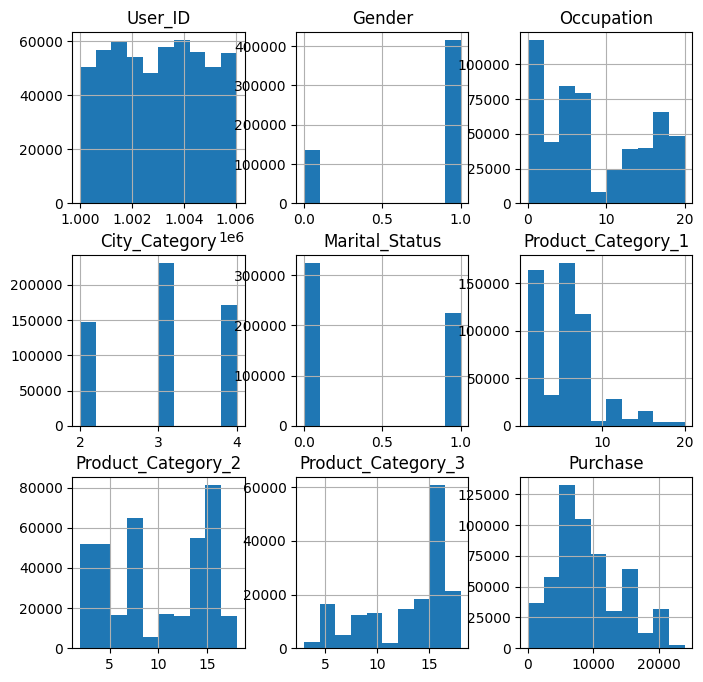

In [ ]:
new_df.hist(figsize=(8,8))
plt.show()

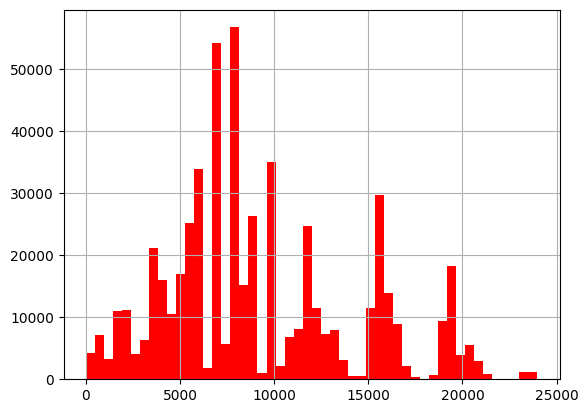

In [ ]:
new_df['Purchase'].hist(bins=50,color='red')
plt.show()

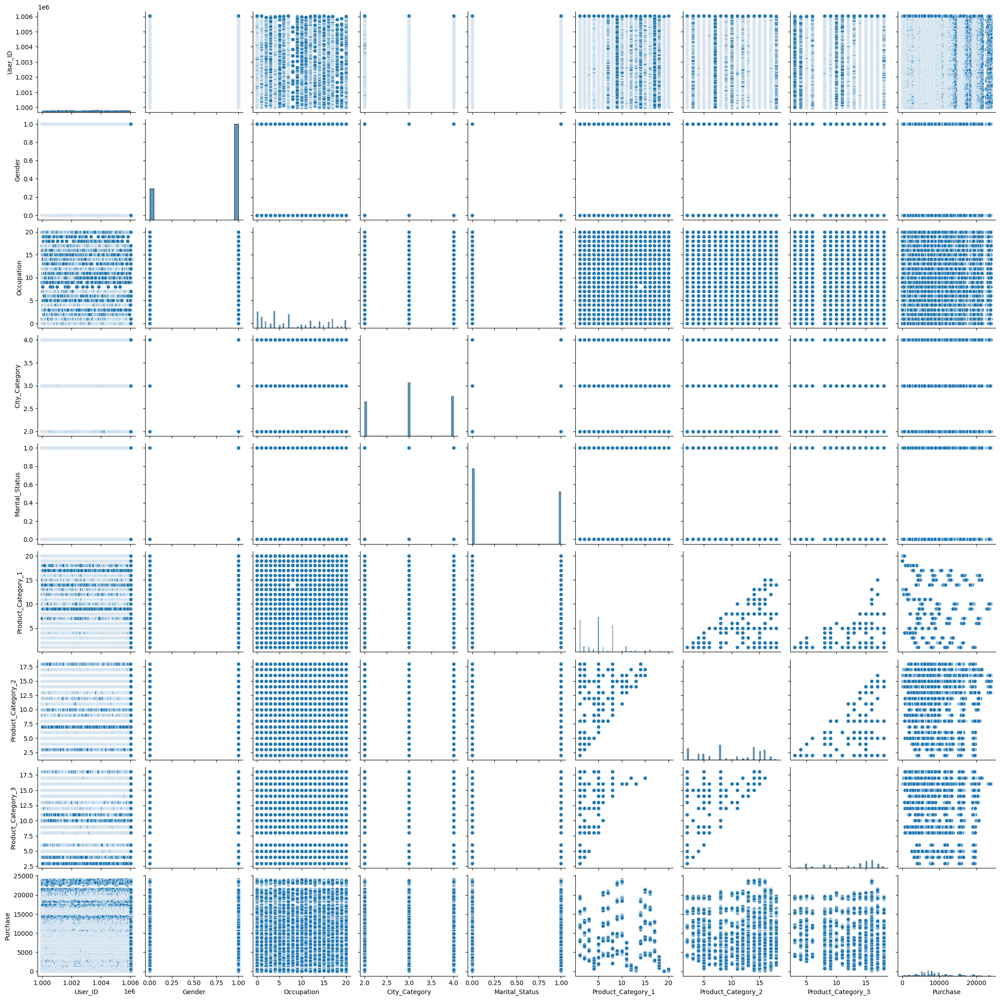

In [ ]:
# sns.pairplot(new_df)

<Axes: >

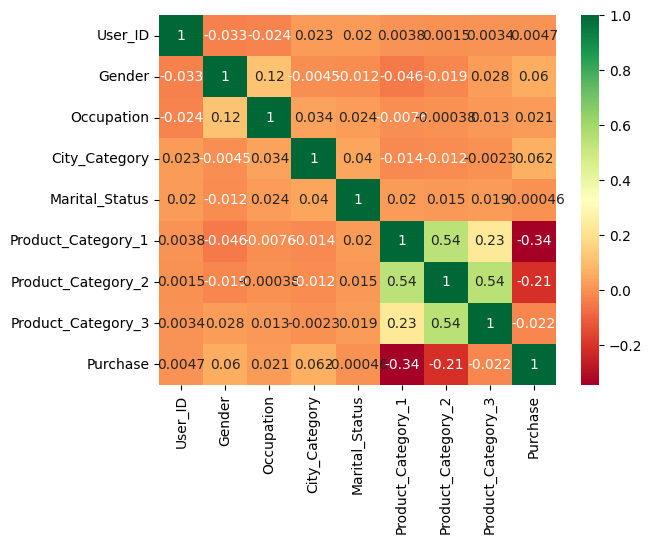

In [ ]:
corr_matrix = new_df.corr(numeric_only=True)
sns.heatmap(corr_matrix, cmap='RdYlGn', annot = True)

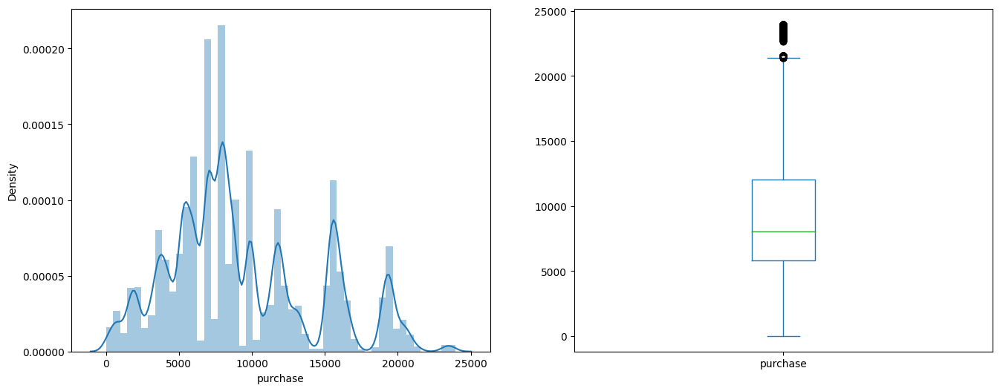

In [ ]:
plt.figure(1)
plt.subplot(121)
sns.distplot(new_df["purchase"])

plt.subplot(122)
new_df["purchase"].plot.box(figsize = (16, 6))
plt.show()

In [ ]:
px.box(new_df,x='Product_Category_1')

In [ ]:
new_df.columns

Index(['User_ID', 'Gender', 'Age', 'Occupation', 'Product_ID', 'City_Category',
       'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category_1',
       'Product_Category_2', 'Product_Category_3', 'Purchase'],
      dtype='object')

In [ ]:
px.box(new_df,x='Product_Category_2')

In [ ]:
px.box(new_df,x='Product_Category_3')